# Afriat

In [1]:
scan=0.10

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: mpjoi9i4
Name: star-carrier-117
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/mpjoi9i4
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-mpjoi9i4/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2528,3292,9423
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2528,2554,1697,3429,1648,3387
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4502,10741
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 677,817,2316
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 677,648,411,861,401,812
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1082,2728
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:25:43, 14.60s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:25:43, 14.60s/it, v_num=i4_1, total_loss_train=3.74e+3, kl_local_train=51.5]

Epoch 2/600:   0%|          | 1/600 [00:14<2:25:43, 14.60s/it, v_num=i4_1, total_loss_train=3.74e+3, kl_local_train=51.5]

Epoch 2/600:   0%|          | 2/600 [00:28<2:20:21, 14.08s/it, v_num=i4_1, total_loss_train=3.74e+3, kl_local_train=51.5]

Epoch 2/600:   0%|          | 2/600 [00:28<2:20:21, 14.08s/it, v_num=i4_1, total_loss_train=3.23e+3, kl_local_train=80.4]

Epoch 3/600:   0%|          | 2/600 [00:28<2:20:21, 14.08s/it, v_num=i4_1, total_loss_train=3.23e+3, kl_local_train=80.4]

Epoch 3/600:   0%|          | 3/600 [00:42<2:19:01, 13.97s/it, v_num=i4_1, total_loss_train=3.23e+3, kl_local_train=80.4]

Epoch 3/600:   0%|          | 3/600 [00:42<2:19:01, 13.97s/it, v_num=i4_1, total_loss_train=3.22e+3, kl_local_train=82.3]

Epoch 4/600:   0%|          | 3/600 [00:42<2:19:01, 13.97s/it, v_num=i4_1, total_loss_train=3.22e+3, kl_local_train=82.3]

Epoch 4/600:   1%|          | 4/600 [00:56<2:18:39, 13.96s/it, v_num=i4_1, total_loss_train=3.22e+3, kl_local_train=82.3]

Epoch 4/600:   1%|          | 4/600 [00:56<2:18:39, 13.96s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=79.9]

Epoch 5/600:   1%|          | 4/600 [00:56<2:18:39, 13.96s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=79.9]

Epoch 5/600:   1%|          | 5/600 [01:10<2:20:31, 14.17s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=79.9]

Epoch 5/600:   1%|          | 5/600 [01:10<2:20:31, 14.17s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=74.3]

Epoch 6/600:   1%|          | 5/600 [01:12<2:20:31, 14.17s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=74.3]

Epoch 6/600:   1%|          | 6/600 [01:25<2:24:16, 14.57s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=74.3]

Epoch 6/600:   1%|          | 6/600 [01:26<2:24:16, 14.57s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:26<2:24:16, 14.57s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:39<2:22:05, 14.38s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=65.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:39<2:22:05, 14.38s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:39<2:22:05, 14.38s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:53<2:20:05, 14.20s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:53<2:20:05, 14.20s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=32.5, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   1%|▏         | 8/600 [01:53<2:20:05, 14.20s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=32.5, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [02:07<2:17:29, 13.96s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=32.5, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [02:07<2:17:29, 13.96s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=26.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035] 

Epoch 10/600:   2%|▏         | 9/600 [02:07<2:17:29, 13.96s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=26.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:20<2:14:48, 13.71s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=26.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:20<2:14:48, 13.71s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 10/600 [02:21<2:14:48, 13.71s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:34<2:17:19, 13.99s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=29.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00737, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:34<2:17:19, 13.99s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]  

Epoch 12/600:   2%|▏         | 11/600 [02:35<2:17:19, 13.99s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 12/600:   2%|▏         | 12/600 [02:48<2:14:27, 13.72s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=36.8, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 12/600:   2%|▏         | 12/600 [02:48<2:14:27, 13.72s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 13/600:   2%|▏         | 12/600 [02:48<2:14:27, 13.72s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 13/600:   2%|▏         | 13/600 [03:01<2:12:27, 13.54s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 13/600:   2%|▏         | 13/600 [03:01<2:12:27, 13.54s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 14/600:   2%|▏         | 13/600 [03:01<2:12:27, 13.54s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 14/600:   2%|▏         | 14/600 [03:14<2:10:54, 13.40s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 14/600:   2%|▏         | 14/600 [03:14<2:10:54, 13.40s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 15/600:   2%|▏         | 14/600 [03:14<2:10:54, 13.40s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 15/600:   2%|▎         | 15/600 [03:27<2:09:57, 13.33s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 15/600:   2%|▎         | 15/600 [03:27<2:09:57, 13.33s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 16/600:   2%|▎         | 15/600 [03:28<2:09:57, 13.33s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 16/600:   3%|▎         | 16/600 [03:41<2:12:41, 13.63s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.081, metric_mi|time_cat_train=0.026, metric_mi|mouse_train=0.0484]

Epoch 16/600:   3%|▎         | 16/600 [03:41<2:12:41, 13.63s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=68.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 17/600:   3%|▎         | 16/600 [03:41<2:12:41, 13.63s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=68.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 17/600:   3%|▎         | 17/600 [03:54<2:10:25, 13.42s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=68.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 17/600:   3%|▎         | 17/600 [03:54<2:10:25, 13.42s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 18/600:   3%|▎         | 17/600 [03:54<2:10:25, 13.42s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 18/600:   3%|▎         | 18/600 [04:07<2:08:42, 13.27s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=72.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 18/600:   3%|▎         | 18/600 [04:07<2:08:42, 13.27s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 19/600:   3%|▎         | 18/600 [04:07<2:08:42, 13.27s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 19/600:   3%|▎         | 19/600 [04:20<2:07:42, 13.19s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 19/600:   3%|▎         | 19/600 [04:20<2:07:42, 13.19s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 20/600:   3%|▎         | 19/600 [04:20<2:07:42, 13.19s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 20/600:   3%|▎         | 20/600 [04:33<2:06:37, 13.10s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=80.6, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 20/600:   3%|▎         | 20/600 [04:33<2:06:37, 13.10s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 21/600:   3%|▎         | 20/600 [04:34<2:06:37, 13.10s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 21/600:   4%|▎         | 21/600 [04:47<2:07:41, 13.23s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0572, metric_mi|time_cat_train=0.0628, metric_mi|mouse_train=0.0819]

Epoch 21/600:   4%|▎         | 21/600 [04:47<2:07:41, 13.23s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103] 

Epoch 22/600:   4%|▎         | 21/600 [04:47<2:07:41, 13.23s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▎         | 22/600 [04:58<2:03:38, 12.83s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=86.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 22/600:   4%|▎         | 22/600 [04:58<2:03:38, 12.83s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=88.9, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▎         | 22/600 [04:59<2:03:38, 12.83s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=88.9, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▍         | 23/600 [05:10<2:00:46, 12.56s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=88.9, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 23/600:   4%|▍         | 23/600 [05:10<2:00:46, 12.56s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 23/600 [05:10<2:00:46, 12.56s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 24/600 [05:22<1:58:42, 12.37s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=92.1, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 24/600:   4%|▍         | 24/600 [05:22<1:58:42, 12.37s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=95.9, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 24/600 [05:22<1:58:42, 12.37s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=95.9, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 25/600 [05:34<1:57:10, 12.23s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=95.9, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 25/600:   4%|▍         | 25/600 [05:34<1:57:10, 12.23s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 25/600 [05:36<1:57:10, 12.23s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 26/600 [05:47<1:59:50, 12.53s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=99.8, metric_mi|status_control_train=0.0609, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.103]

Epoch 26/600:   4%|▍         | 26/600 [05:47<1:59:50, 12.53s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]    

Epoch 27/600:   4%|▍         | 26/600 [05:47<1:59:50, 12.53s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:59<1:57:46, 12.33s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 27/600:   4%|▍         | 27/600 [05:59<1:57:46, 12.33s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 28/600:   4%|▍         | 27/600 [05:59<1:57:46, 12.33s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [06:11<1:56:18, 12.20s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=104, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 28/600:   5%|▍         | 28/600 [06:11<1:56:18, 12.20s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 28/600 [06:11<1:56:18, 12.20s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [06:23<1:55:16, 12.11s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 29/600:   5%|▍         | 29/600 [06:23<1:55:16, 12.11s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▍         | 29/600 [06:23<1:55:16, 12.11s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:36<1:55:59, 12.21s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 30/600:   5%|▌         | 30/600 [06:36<1:55:59, 12.21s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 30/600 [06:37<1:55:59, 12.21s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:50<2:01:45, 12.84s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.0795, metric_mi|zone_train=0.06, metric_mi|time_cat_train=0.0943, metric_mi|mouse_train=0.11]

Epoch 31/600:   5%|▌         | 31/600 [06:50<2:01:45, 12.84s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 32/600:   5%|▌         | 31/600 [06:50<2:01:45, 12.84s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 32/600:   5%|▌         | 32/600 [07:03<2:01:52, 12.87s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=104, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 32/600:   5%|▌         | 32/600 [07:03<2:01:52, 12.87s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 33/600:   5%|▌         | 32/600 [07:03<2:01:52, 12.87s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 33/600:   6%|▌         | 33/600 [07:16<2:01:55, 12.90s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 33/600:   6%|▌         | 33/600 [07:16<2:01:55, 12.90s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 33/600 [07:16<2:01:55, 12.90s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 34/600 [07:29<2:01:49, 12.91s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=106, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 34/600:   6%|▌         | 34/600 [07:29<2:01:49, 12.91s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 34/600 [07:29<2:01:49, 12.91s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 35/600 [07:42<2:01:40, 12.92s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=107, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 35/600:   6%|▌         | 35/600 [07:42<2:01:40, 12.92s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 35/600 [07:43<2:01:40, 12.92s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 36/600 [07:56<2:05:11, 13.32s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.09, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0974, metric_mi|mouse_train=0.111]

Epoch 36/600:   6%|▌         | 36/600 [07:56<2:05:11, 13.32s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111] 

Epoch 37/600:   6%|▌         | 36/600 [07:56<2:05:11, 13.32s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 37/600:   6%|▌         | 37/600 [08:09<2:03:52, 13.20s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 37/600:   6%|▌         | 37/600 [08:09<2:03:52, 13.20s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|▌         | 37/600 [08:09<2:03:52, 13.20s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|▋         | 38/600 [08:22<2:02:21, 13.06s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 38/600:   6%|▋         | 38/600 [08:22<2:02:21, 13.06s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|▋         | 38/600 [08:22<2:02:21, 13.06s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|▋         | 39/600 [08:35<2:01:50, 13.03s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=104, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 39/600:   6%|▋         | 39/600 [08:35<2:01:50, 13.03s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 40/600:   6%|▋         | 39/600 [08:35<2:01:50, 13.03s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 40/600:   7%|▋         | 40/600 [08:48<2:01:32, 13.02s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 40/600:   7%|▋         | 40/600 [08:48<2:01:32, 13.02s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111] 

Epoch 41/600:   7%|▋         | 40/600 [08:49<2:01:32, 13.02s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 41/600:   7%|▋         | 41/600 [09:02<2:04:55, 13.41s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=102, metric_mi|status_control_train=0.0945, metric_mi|zone_train=0.086, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.111]

Epoch 41/600:   7%|▋         | 41/600 [09:02<2:04:55, 13.41s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 42/600:   7%|▋         | 41/600 [09:02<2:04:55, 13.41s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 42/600:   7%|▋         | 42/600 [09:15<2:03:43, 13.30s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 42/600:   7%|▋         | 42/600 [09:15<2:03:43, 13.30s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 43/600:   7%|▋         | 42/600 [09:15<2:03:43, 13.30s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 43/600:   7%|▋         | 43/600 [09:28<2:02:46, 13.22s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 43/600:   7%|▋         | 43/600 [09:28<2:02:46, 13.22s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 44/600:   7%|▋         | 43/600 [09:28<2:02:46, 13.22s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 44/600:   7%|▋         | 44/600 [09:41<2:01:56, 13.16s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.5, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 44/600:   7%|▋         | 44/600 [09:41<2:01:56, 13.16s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 45/600:   7%|▋         | 44/600 [09:41<2:01:56, 13.16s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 45/600:   8%|▊         | 45/600 [09:54<2:01:09, 13.10s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=98.3, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 45/600:   8%|▊         | 45/600 [09:54<2:01:09, 13.10s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=97, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112] 

Epoch 46/600:   8%|▊         | 45/600 [09:55<2:01:09, 13.10s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=97, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 46/600:   8%|▊         | 46/600 [10:08<2:04:24, 13.47s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=97, metric_mi|status_control_train=0.102, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.112]

Epoch 46/600:   8%|▊         | 46/600 [10:08<2:04:24, 13.47s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 47/600:   8%|▊         | 46/600 [10:08<2:04:24, 13.47s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 47/600:   8%|▊         | 47/600 [10:21<2:02:48, 13.33s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=96.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 47/600:   8%|▊         | 47/600 [10:21<2:02:48, 13.33s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=95.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 48/600:   8%|▊         | 47/600 [10:21<2:02:48, 13.33s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=95.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 48/600:   8%|▊         | 48/600 [10:34<2:01:44, 13.23s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=95.8, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 48/600:   8%|▊         | 48/600 [10:34<2:01:44, 13.23s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=95.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 49/600:   8%|▊         | 48/600 [10:34<2:01:44, 13.23s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=95.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 49/600:   8%|▊         | 49/600 [10:47<2:00:47, 13.15s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=95.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 49/600:   8%|▊         | 49/600 [10:47<2:00:47, 13.15s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 50/600:   8%|▊         | 49/600 [10:47<2:00:47, 13.15s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 50/600:   8%|▊         | 50/600 [11:00<1:59:59, 13.09s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 50/600:   8%|▊         | 50/600 [11:00<1:59:59, 13.09s/it, v_num=i4_1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]  

Epoch 51/600:   8%|▊         | 50/600 [11:02<1:59:59, 13.09s/it, v_num=i4_1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 51/600:   8%|▊         | 51/600 [11:14<2:03:03, 13.45s/it, v_num=i4_1, total_loss_train=3.22e+3, kl_local_train=96, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.146, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.114]

Epoch 51/600:   8%|▊         | 51/600 [11:14<2:03:03, 13.45s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 52/600:   8%|▊         | 51/600 [11:14<2:03:03, 13.45s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 52/600:   9%|▊         | 52/600 [11:27<2:01:01, 13.25s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 52/600:   9%|▊         | 52/600 [11:27<2:01:01, 13.25s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 53/600:   9%|▊         | 52/600 [11:27<2:01:01, 13.25s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 53/600:   9%|▉         | 53/600 [11:40<2:00:18, 13.20s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=94.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 53/600:   9%|▉         | 53/600 [11:40<2:00:18, 13.20s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=93.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 54/600:   9%|▉         | 53/600 [11:40<2:00:18, 13.20s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=93.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 54/600:   9%|▉         | 54/600 [11:53<1:59:31, 13.13s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=93.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 54/600:   9%|▉         | 54/600 [11:53<1:59:31, 13.13s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=92.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 55/600:   9%|▉         | 54/600 [11:53<1:59:31, 13.13s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=92.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 55/600:   9%|▉         | 55/600 [12:06<1:58:54, 13.09s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=92.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 55/600:   9%|▉         | 55/600 [12:06<1:58:54, 13.09s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=91.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 56/600:   9%|▉         | 55/600 [12:08<1:58:54, 13.09s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=91.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 56/600:   9%|▉         | 56/600 [12:21<2:02:05, 13.47s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=91.2, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 56/600:   9%|▉         | 56/600 [12:21<2:02:05, 13.47s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 57/600:   9%|▉         | 56/600 [12:21<2:02:05, 13.47s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 57/600:  10%|▉         | 57/600 [12:34<2:00:40, 13.33s/it, v_num=i4_1, total_loss_train=3.21e+3, kl_local_train=90.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 57/600:  10%|▉         | 57/600 [12:34<2:00:40, 13.33s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117] 

Epoch 58/600:  10%|▉         | 57/600 [12:34<2:00:40, 13.33s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 58/600 [12:47<1:59:30, 13.23s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=90.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 58/600:  10%|▉         | 58/600 [12:47<1:59:30, 13.23s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=90, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]  

Epoch 59/600:  10%|▉         | 58/600 [12:47<1:59:30, 13.23s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=90, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 59/600 [13:00<1:58:46, 13.17s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=90, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 59/600:  10%|▉         | 59/600 [13:00<1:58:46, 13.17s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|▉         | 59/600 [13:00<1:58:46, 13.17s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|█         | 60/600 [13:13<1:58:00, 13.11s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 60/600:  10%|█         | 60/600 [13:13<1:58:00, 13.11s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=87.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 60/600 [13:14<1:58:00, 13.11s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=87.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 61/600 [13:27<2:01:16, 13.50s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=87.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.117]

Epoch 61/600:  10%|█         | 61/600 [13:27<2:01:16, 13.50s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=86.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 62/600:  10%|█         | 61/600 [13:27<2:01:16, 13.50s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=86.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 62/600:  10%|█         | 62/600 [13:40<1:59:49, 13.36s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=86.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 62/600:  10%|█         | 62/600 [13:40<1:59:49, 13.36s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=86, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]  

Epoch 63/600:  10%|█         | 62/600 [13:40<1:59:49, 13.36s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=86, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 63/600:  10%|█         | 63/600 [13:53<1:58:47, 13.27s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=86, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 63/600:  10%|█         | 63/600 [13:53<1:58:47, 13.27s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=84.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 64/600:  10%|█         | 63/600 [13:53<1:58:47, 13.27s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=84.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 64/600:  11%|█         | 64/600 [14:06<1:57:50, 13.19s/it, v_num=i4_1, total_loss_train=3.2e+3, kl_local_train=84.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 64/600:  11%|█         | 64/600 [14:06<1:57:50, 13.19s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=85.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 65/600:  11%|█         | 64/600 [14:06<1:57:50, 13.19s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=85.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 65/600:  11%|█         | 65/600 [14:20<1:57:58, 13.23s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=85.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 65/600:  11%|█         | 65/600 [14:20<1:57:58, 13.23s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 66/600:  11%|█         | 65/600 [14:21<1:57:58, 13.23s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 66/600:  11%|█         | 66/600 [14:34<2:01:06, 13.61s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.115, metric_mi|mouse_train=0.116]

Epoch 66/600:  11%|█         | 66/600 [14:34<2:01:06, 13.61s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114] 

Epoch 67/600:  11%|█         | 66/600 [14:34<2:01:06, 13.61s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 67/600:  11%|█         | 67/600 [14:47<1:59:40, 13.47s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=83.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 67/600:  11%|█         | 67/600 [14:47<1:59:40, 13.47s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 68/600:  11%|█         | 67/600 [14:47<1:59:40, 13.47s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 68/600:  11%|█▏        | 68/600 [15:00<1:58:40, 13.39s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=82.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 68/600:  11%|█▏        | 68/600 [15:00<1:58:40, 13.39s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=82, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]  

Epoch 69/600:  11%|█▏        | 68/600 [15:00<1:58:40, 13.39s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=82, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 69/600:  12%|█▏        | 69/600 [15:13<1:57:51, 13.32s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=82, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 69/600:  12%|█▏        | 69/600 [15:13<1:57:51, 13.32s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=81.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 70/600:  12%|█▏        | 69/600 [15:14<1:57:51, 13.32s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=81.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 70/600:  12%|█▏        | 70/600 [15:27<1:57:05, 13.26s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=81.6, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 70/600:  12%|█▏        | 70/600 [15:27<1:57:05, 13.26s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=81.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 71/600:  12%|█▏        | 70/600 [15:28<1:57:05, 13.26s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=81.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 71/600:  12%|█▏        | 71/600 [15:41<2:00:26, 13.66s/it, v_num=i4_1, total_loss_train=3.19e+3, kl_local_train=81.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.114]

Epoch 71/600:  12%|█▏        | 71/600 [15:41<2:00:26, 13.66s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=80.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 72/600:  12%|█▏        | 71/600 [15:41<2:00:26, 13.66s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=80.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 72/600:  12%|█▏        | 72/600 [15:55<1:59:23, 13.57s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=80.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 72/600:  12%|█▏        | 72/600 [15:55<1:59:23, 13.57s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=80.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 73/600:  12%|█▏        | 72/600 [15:55<1:59:23, 13.57s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=80.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 73/600:  12%|█▏        | 73/600 [16:08<1:58:36, 13.50s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=80.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 73/600:  12%|█▏        | 73/600 [16:08<1:58:36, 13.50s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=79.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 74/600:  12%|█▏        | 73/600 [16:08<1:58:36, 13.50s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=79.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 74/600:  12%|█▏        | 74/600 [16:21<1:57:51, 13.44s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=79.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 74/600:  12%|█▏        | 74/600 [16:21<1:57:51, 13.44s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=79.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 75/600:  12%|█▏        | 74/600 [16:21<1:57:51, 13.44s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=79.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 75/600:  12%|█▎        | 75/600 [16:34<1:56:44, 13.34s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=79.3, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 75/600:  12%|█▎        | 75/600 [16:34<1:56:44, 13.34s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 76/600:  12%|█▎        | 75/600 [16:36<1:56:44, 13.34s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 76/600:  13%|█▎        | 76/600 [16:49<2:00:13, 13.77s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.149, metric_mi|time_cat_train=0.11, metric_mi|mouse_train=0.112]

Epoch 76/600:  13%|█▎        | 76/600 [16:49<2:00:13, 13.77s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 77/600:  13%|█▎        | 76/600 [16:49<2:00:13, 13.77s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 77/600:  13%|█▎        | 77/600 [17:02<1:58:50, 13.63s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 77/600:  13%|█▎        | 77/600 [17:02<1:58:50, 13.63s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]  

Epoch 78/600:  13%|█▎        | 77/600 [17:02<1:58:50, 13.63s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 78/600:  13%|█▎        | 78/600 [17:16<1:57:56, 13.56s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=78, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 78/600:  13%|█▎        | 78/600 [17:16<1:57:56, 13.56s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=76.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 79/600:  13%|█▎        | 78/600 [17:16<1:57:56, 13.56s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=76.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 79/600:  13%|█▎        | 79/600 [17:29<1:57:08, 13.49s/it, v_num=i4_1, total_loss_train=3.18e+3, kl_local_train=76.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 79/600:  13%|█▎        | 79/600 [17:29<1:57:08, 13.49s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=77.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 80/600:  13%|█▎        | 79/600 [17:29<1:57:08, 13.49s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=77.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 80/600:  13%|█▎        | 80/600 [17:42<1:56:22, 13.43s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=77.2, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 80/600:  13%|█▎        | 80/600 [17:42<1:56:22, 13.43s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 81/600:  13%|█▎        | 80/600 [17:44<1:56:22, 13.43s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 81/600:  14%|█▎        | 81/600 [17:57<1:59:33, 13.82s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76.1, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.11]

Epoch 81/600:  14%|█▎        | 81/600 [17:57<1:59:33, 13.82s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107] 

Epoch 82/600:  14%|█▎        | 81/600 [17:57<1:59:33, 13.82s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 82/600:  14%|█▎        | 82/600 [18:11<1:58:15, 13.70s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=76, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 82/600:  14%|█▎        | 82/600 [18:11<1:58:15, 13.70s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 83/600:  14%|█▎        | 82/600 [18:11<1:58:15, 13.70s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 83/600:  14%|█▍        | 83/600 [18:24<1:57:13, 13.61s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=75.5, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 83/600:  14%|█▍        | 83/600 [18:24<1:57:13, 13.61s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 84/600:  14%|█▍        | 83/600 [18:24<1:57:13, 13.61s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 84/600:  14%|█▍        | 84/600 [18:37<1:56:36, 13.56s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 84/600:  14%|█▍        | 84/600 [18:37<1:56:36, 13.56s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 85/600:  14%|█▍        | 84/600 [18:37<1:56:36, 13.56s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 85/600:  14%|█▍        | 85/600 [18:51<1:55:49, 13.49s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 85/600:  14%|█▍        | 85/600 [18:51<1:55:49, 13.49s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 86/600:  14%|█▍        | 85/600 [18:52<1:55:49, 13.49s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 86/600:  14%|█▍        | 86/600 [19:05<1:58:48, 13.87s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=74.4, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.107]

Epoch 86/600:  14%|█▍        | 86/600 [19:05<1:58:48, 13.87s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=73.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 87/600:  14%|█▍        | 86/600 [19:05<1:58:48, 13.87s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=73.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 87/600:  14%|█▍        | 87/600 [19:19<1:57:21, 13.73s/it, v_num=i4_1, total_loss_train=3.17e+3, kl_local_train=73.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 87/600:  14%|█▍        | 87/600 [19:19<1:57:21, 13.73s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=73.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 88/600:  14%|█▍        | 87/600 [19:19<1:57:21, 13.73s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=73.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 88/600:  15%|█▍        | 88/600 [19:32<1:56:34, 13.66s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=73.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 88/600:  15%|█▍        | 88/600 [19:32<1:56:34, 13.66s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 89/600:  15%|█▍        | 88/600 [19:32<1:56:34, 13.66s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 89/600:  15%|█▍        | 89/600 [19:46<1:55:39, 13.58s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=73.2, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 89/600:  15%|█▍        | 89/600 [19:46<1:55:39, 13.58s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 90/600:  15%|█▍        | 89/600 [19:46<1:55:39, 13.58s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 90/600:  15%|█▌        | 90/600 [19:59<1:55:03, 13.54s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.7, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 90/600:  15%|█▌        | 90/600 [19:59<1:55:03, 13.54s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 91/600:  15%|█▌        | 90/600 [20:01<1:55:03, 13.54s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 91/600:  15%|█▌        | 91/600 [20:14<1:57:52, 13.89s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.3, metric_mi|status_control_train=0.129, metric_mi|zone_train=0.141, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.105]

Epoch 91/600:  15%|█▌        | 91/600 [20:14<1:57:52, 13.89s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 92/600:  15%|█▌        | 91/600 [20:14<1:57:52, 13.89s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 92/600:  15%|█▌        | 92/600 [20:27<1:56:20, 13.74s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=72.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 92/600:  15%|█▌        | 92/600 [20:27<1:56:20, 13.74s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 93/600:  15%|█▌        | 92/600 [20:27<1:56:20, 13.74s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 93/600:  16%|█▌        | 93/600 [20:41<1:55:13, 13.64s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=71.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 93/600:  16%|█▌        | 93/600 [20:41<1:55:13, 13.64s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=71.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 94/600:  16%|█▌        | 93/600 [20:41<1:55:13, 13.64s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=71.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 94/600:  16%|█▌        | 94/600 [20:54<1:54:02, 13.52s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=71.1, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 94/600:  16%|█▌        | 94/600 [20:54<1:54:02, 13.52s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=70.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 95/600:  16%|█▌        | 94/600 [20:54<1:54:02, 13.52s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=70.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 95/600:  16%|█▌        | 95/600 [21:07<1:53:09, 13.45s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=70.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 95/600:  16%|█▌        | 95/600 [21:07<1:53:09, 13.45s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=70.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 96/600:  16%|█▌        | 95/600 [21:09<1:53:09, 13.45s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=70.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 96/600:  16%|█▌        | 96/600 [21:22<1:55:54, 13.80s/it, v_num=i4_1, total_loss_train=3.16e+3, kl_local_train=70.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.0977, metric_mi|mouse_train=0.104]

Epoch 96/600:  16%|█▌        | 96/600 [21:22<1:55:54, 13.80s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103] 

Epoch 97/600:  16%|█▌        | 96/600 [21:22<1:55:54, 13.80s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 97/600:  16%|█▌        | 97/600 [21:35<1:53:58, 13.60s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=70.3, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 97/600:  16%|█▌        | 97/600 [21:35<1:53:58, 13.60s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 98/600:  16%|█▌        | 97/600 [21:35<1:53:58, 13.60s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 98/600:  16%|█▋        | 98/600 [21:48<1:52:05, 13.40s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=70.2, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 98/600:  16%|█▋        | 98/600 [21:48<1:52:05, 13.40s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 99/600:  16%|█▋        | 98/600 [21:48<1:52:05, 13.40s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 99/600:  16%|█▋        | 99/600 [22:01<1:51:14, 13.32s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 99/600:  16%|█▋        | 99/600 [22:01<1:51:14, 13.32s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 100/600:  16%|█▋        | 99/600 [22:01<1:51:14, 13.32s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 100/600:  17%|█▋        | 100/600 [22:14<1:50:24, 13.25s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 100/600:  17%|█▋        | 100/600 [22:14<1:50:24, 13.25s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 101/600:  17%|█▋        | 100/600 [22:16<1:50:24, 13.25s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 101/600:  17%|█▋        | 101/600 [22:29<1:53:07, 13.60s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=69.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.097, metric_mi|mouse_train=0.103]

Epoch 101/600:  17%|█▋        | 101/600 [22:29<1:53:07, 13.60s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 102/600:  17%|█▋        | 101/600 [22:29<1:53:07, 13.60s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 102/600:  17%|█▋        | 102/600 [22:42<1:51:33, 13.44s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.7, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 102/600:  17%|█▋        | 102/600 [22:42<1:51:33, 13.44s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 103/600:  17%|█▋        | 102/600 [22:42<1:51:33, 13.44s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 103/600:  17%|█▋        | 103/600 [22:55<1:50:32, 13.34s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 103/600:  17%|█▋        | 103/600 [22:55<1:50:32, 13.34s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 104/600:  17%|█▋        | 103/600 [22:55<1:50:32, 13.34s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 104/600:  17%|█▋        | 104/600 [23:08<1:49:35, 13.26s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68.3, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 104/600:  17%|█▋        | 104/600 [23:08<1:49:35, 13.26s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]  

Epoch 105/600:  17%|█▋        | 104/600 [23:08<1:49:35, 13.26s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 105/600:  18%|█▊        | 105/600 [23:21<1:48:40, 13.17s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=68, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 105/600:  18%|█▊        | 105/600 [23:21<1:48:40, 13.17s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=67.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 106/600:  18%|█▊        | 105/600 [23:22<1:48:40, 13.17s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=67.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 106/600:  18%|█▊        | 106/600 [23:35<1:51:44, 13.57s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=67.8, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.0952, metric_mi|mouse_train=0.103]

Epoch 106/600:  18%|█▊        | 106/600 [23:35<1:51:44, 13.57s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101] 

Epoch 107/600:  18%|█▊        | 106/600 [23:35<1:51:44, 13.57s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 107/600:  18%|█▊        | 107/600 [23:48<1:50:12, 13.41s/it, v_num=i4_1, total_loss_train=3.15e+3, kl_local_train=67.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 107/600:  18%|█▊        | 107/600 [23:48<1:50:12, 13.41s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 108/600:  18%|█▊        | 107/600 [23:48<1:50:12, 13.41s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 108/600:  18%|█▊        | 108/600 [24:01<1:48:53, 13.28s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.9, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 108/600:  18%|█▊        | 108/600 [24:01<1:48:53, 13.28s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 109/600:  18%|█▊        | 108/600 [24:01<1:48:53, 13.28s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 109/600:  18%|█▊        | 109/600 [24:14<1:48:09, 13.22s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=67.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 109/600:  18%|█▊        | 109/600 [24:14<1:48:09, 13.22s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 110/600:  18%|█▊        | 109/600 [24:14<1:48:09, 13.22s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 110/600:  18%|█▊        | 110/600 [24:27<1:47:39, 13.18s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.7, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 110/600:  18%|█▊        | 110/600 [24:27<1:47:39, 13.18s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 111/600:  18%|█▊        | 110/600 [24:29<1:47:39, 13.18s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 111/600:  18%|█▊        | 111/600 [24:42<1:50:40, 13.58s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.093, metric_mi|mouse_train=0.101]

Epoch 111/600:  18%|█▊        | 111/600 [24:42<1:50:40, 13.58s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 112/600:  18%|█▊        | 111/600 [24:42<1:50:40, 13.58s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 112/600:  19%|█▊        | 112/600 [24:55<1:49:26, 13.46s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 112/600:  19%|█▊        | 112/600 [24:55<1:49:26, 13.46s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 113/600:  19%|█▊        | 112/600 [24:55<1:49:26, 13.46s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 113/600:  19%|█▉        | 113/600 [25:08<1:48:22, 13.35s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=66.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 113/600:  19%|█▉        | 113/600 [25:08<1:48:22, 13.35s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 114/600:  19%|█▉        | 113/600 [25:08<1:48:22, 13.35s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 114/600:  19%|█▉        | 114/600 [25:21<1:47:30, 13.27s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.8, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 114/600:  19%|█▉        | 114/600 [25:21<1:47:30, 13.27s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 115/600:  19%|█▉        | 114/600 [25:21<1:47:30, 13.27s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 115/600:  19%|█▉        | 115/600 [25:34<1:46:42, 13.20s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.6, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 115/600:  19%|█▉        | 115/600 [25:34<1:46:42, 13.20s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 116/600:  19%|█▉        | 115/600 [25:36<1:46:42, 13.20s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 116/600:  19%|█▉        | 116/600 [25:49<1:49:29, 13.57s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=65.3, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.0898, metric_mi|mouse_train=0.0988]

Epoch 116/600:  19%|█▉        | 116/600 [25:49<1:49:29, 13.57s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 117/600:  19%|█▉        | 116/600 [25:49<1:49:29, 13.57s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 117/600:  20%|█▉        | 117/600 [26:02<1:47:46, 13.39s/it, v_num=i4_1, total_loss_train=3.14e+3, kl_local_train=64.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 117/600:  20%|█▉        | 117/600 [26:02<1:47:46, 13.39s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 118/600:  20%|█▉        | 117/600 [26:02<1:47:46, 13.39s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 118/600:  20%|█▉        | 118/600 [26:15<1:46:45, 13.29s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.9, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 118/600:  20%|█▉        | 118/600 [26:15<1:46:45, 13.29s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 119/600:  20%|█▉        | 118/600 [26:15<1:46:45, 13.29s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 119/600:  20%|█▉        | 119/600 [26:28<1:46:08, 13.24s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.6, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 119/600:  20%|█▉        | 119/600 [26:28<1:46:08, 13.24s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 120/600:  20%|█▉        | 119/600 [26:28<1:46:08, 13.24s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 120/600:  20%|██        | 120/600 [26:41<1:45:25, 13.18s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.4, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 120/600:  20%|██        | 120/600 [26:41<1:45:25, 13.18s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 121/600:  20%|██        | 120/600 [26:42<1:45:25, 13.18s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 121/600:  20%|██        | 121/600 [26:55<1:48:23, 13.58s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64.1, metric_mi|status_control_train=0.115, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.0859, metric_mi|mouse_train=0.0964]

Epoch 121/600:  20%|██        | 121/600 [26:55<1:48:23, 13.58s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]   

Epoch 122/600:  20%|██        | 121/600 [26:56<1:48:23, 13.58s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 122/600:  20%|██        | 122/600 [27:09<1:47:06, 13.44s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=64, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 122/600:  20%|██        | 122/600 [27:09<1:47:06, 13.44s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 123/600:  20%|██        | 122/600 [27:09<1:47:06, 13.44s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 123/600:  20%|██        | 123/600 [27:22<1:46:13, 13.36s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 123/600:  20%|██        | 123/600 [27:22<1:46:13, 13.36s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 124/600:  20%|██        | 123/600 [27:22<1:46:13, 13.36s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 124/600:  21%|██        | 124/600 [27:35<1:45:22, 13.28s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 124/600:  21%|██        | 124/600 [27:35<1:45:22, 13.28s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 125/600:  21%|██        | 124/600 [27:35<1:45:22, 13.28s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 125/600:  21%|██        | 125/600 [27:48<1:44:40, 13.22s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 125/600:  21%|██        | 125/600 [27:48<1:44:40, 13.22s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 126/600:  21%|██        | 125/600 [27:49<1:44:40, 13.22s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 126/600:  21%|██        | 126/600 [28:02<1:47:22, 13.59s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.0832, metric_mi|mouse_train=0.0945]

Epoch 126/600:  21%|██        | 126/600 [28:02<1:47:22, 13.59s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 127/600:  21%|██        | 126/600 [28:02<1:47:22, 13.59s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 127/600:  21%|██        | 127/600 [28:16<1:45:56, 13.44s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=62.9, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 127/600:  21%|██        | 127/600 [28:16<1:45:56, 13.44s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]  

Epoch 128/600:  21%|██        | 127/600 [28:16<1:45:56, 13.44s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 128/600:  21%|██▏       | 128/600 [28:28<1:44:35, 13.30s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=63, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 128/600:  21%|██▏       | 128/600 [28:28<1:44:35, 13.30s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 129/600:  21%|██▏       | 128/600 [28:28<1:44:35, 13.30s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 129/600:  22%|██▏       | 129/600 [28:42<1:44:00, 13.25s/it, v_num=i4_1, total_loss_train=3.13e+3, kl_local_train=62.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 129/600:  22%|██▏       | 129/600 [28:42<1:44:00, 13.25s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 130/600:  22%|██▏       | 129/600 [28:42<1:44:00, 13.25s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 130/600:  22%|██▏       | 130/600 [28:55<1:43:27, 13.21s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=62.1, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 130/600:  22%|██▏       | 130/600 [28:55<1:43:27, 13.21s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 131/600:  22%|██▏       | 130/600 [28:56<1:43:27, 13.21s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 131/600:  22%|██▏       | 131/600 [29:09<1:46:08, 13.58s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.0822, metric_mi|mouse_train=0.0939]

Epoch 131/600:  22%|██▏       | 131/600 [29:09<1:46:08, 13.58s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 132/600:  22%|██▏       | 131/600 [29:09<1:46:08, 13.58s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 132/600:  22%|██▏       | 132/600 [29:22<1:45:05, 13.47s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 132/600:  22%|██▏       | 132/600 [29:22<1:45:05, 13.47s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 133/600:  22%|██▏       | 132/600 [29:22<1:45:05, 13.47s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 133/600:  22%|██▏       | 133/600 [29:36<1:44:41, 13.45s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 133/600:  22%|██▏       | 133/600 [29:36<1:44:41, 13.45s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 134/600:  22%|██▏       | 133/600 [29:36<1:44:41, 13.45s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 134/600:  22%|██▏       | 134/600 [29:49<1:44:07, 13.41s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 134/600:  22%|██▏       | 134/600 [29:49<1:44:07, 13.41s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 135/600:  22%|██▏       | 134/600 [29:49<1:44:07, 13.41s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 135/600:  22%|██▎       | 135/600 [30:02<1:43:17, 13.33s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 135/600:  22%|██▎       | 135/600 [30:02<1:43:17, 13.33s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 136/600:  22%|██▎       | 135/600 [30:04<1:43:17, 13.33s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 136/600:  23%|██▎       | 136/600 [30:17<1:45:51, 13.69s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=61.2, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.0816, metric_mi|mouse_train=0.0934]

Epoch 136/600:  23%|██▎       | 136/600 [30:17<1:45:51, 13.69s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 137/600:  23%|██▎       | 136/600 [30:17<1:45:51, 13.69s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 137/600:  23%|██▎       | 137/600 [30:30<1:44:21, 13.52s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.9, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 137/600:  23%|██▎       | 137/600 [30:30<1:44:21, 13.52s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 138/600:  23%|██▎       | 137/600 [30:30<1:44:21, 13.52s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 138/600:  23%|██▎       | 138/600 [30:43<1:43:27, 13.44s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 138/600:  23%|██▎       | 138/600 [30:43<1:43:27, 13.44s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 139/600:  23%|██▎       | 138/600 [30:43<1:43:27, 13.44s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 139/600:  23%|██▎       | 139/600 [30:56<1:42:54, 13.39s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 139/600:  23%|██▎       | 139/600 [30:56<1:42:54, 13.39s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 140/600:  23%|██▎       | 139/600 [30:56<1:42:54, 13.39s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 140/600:  23%|██▎       | 140/600 [31:10<1:42:10, 13.33s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 140/600:  23%|██▎       | 140/600 [31:10<1:42:10, 13.33s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 141/600:  23%|██▎       | 140/600 [31:11<1:42:10, 13.33s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 141/600:  24%|██▎       | 141/600 [31:24<1:44:49, 13.70s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.5, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0799, metric_mi|mouse_train=0.0923]

Epoch 141/600:  24%|██▎       | 141/600 [31:24<1:44:49, 13.70s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 142/600:  24%|██▎       | 141/600 [31:24<1:44:49, 13.70s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 142/600:  24%|██▎       | 142/600 [31:37<1:43:31, 13.56s/it, v_num=i4_1, total_loss_train=3.12e+3, kl_local_train=60.4, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 142/600:  24%|██▎       | 142/600 [31:37<1:43:31, 13.56s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]  

Epoch 143/600:  24%|██▎       | 142/600 [31:37<1:43:31, 13.56s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 143/600:  24%|██▍       | 143/600 [31:51<1:42:35, 13.47s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=60, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 143/600:  24%|██▍       | 143/600 [31:51<1:42:35, 13.47s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 144/600:  24%|██▍       | 143/600 [31:51<1:42:35, 13.47s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 144/600:  24%|██▍       | 144/600 [32:04<1:41:52, 13.41s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 144/600:  24%|██▍       | 144/600 [32:04<1:41:52, 13.41s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 145/600:  24%|██▍       | 144/600 [32:04<1:41:52, 13.41s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 145/600:  24%|██▍       | 145/600 [32:17<1:41:10, 13.34s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 145/600:  24%|██▍       | 145/600 [32:17<1:41:10, 13.34s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 146/600:  24%|██▍       | 145/600 [32:19<1:41:10, 13.34s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 146/600:  24%|██▍       | 146/600 [32:32<1:43:46, 13.71s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0922]

Epoch 146/600:  24%|██▍       | 146/600 [32:32<1:43:46, 13.71s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 147/600:  24%|██▍       | 146/600 [32:32<1:43:46, 13.71s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 147/600:  24%|██▍       | 147/600 [32:45<1:42:35, 13.59s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 147/600:  24%|██▍       | 147/600 [32:45<1:42:35, 13.59s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 148/600:  24%|██▍       | 147/600 [32:45<1:42:35, 13.59s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 148/600:  25%|██▍       | 148/600 [32:58<1:41:36, 13.49s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.4, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 148/600:  25%|██▍       | 148/600 [32:58<1:41:36, 13.49s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 149/600:  25%|██▍       | 148/600 [32:58<1:41:36, 13.49s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 149/600:  25%|██▍       | 149/600 [33:11<1:40:50, 13.41s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59.2, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 149/600:  25%|██▍       | 149/600 [33:11<1:40:50, 13.41s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]  

Epoch 150/600:  25%|██▍       | 149/600 [33:12<1:40:50, 13.41s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 150/600:  25%|██▌       | 150/600 [33:25<1:40:00, 13.33s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=59, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 150/600:  25%|██▌       | 150/600 [33:25<1:40:00, 13.33s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 151/600:  25%|██▌       | 150/600 [33:26<1:40:00, 13.33s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 151/600:  25%|██▌       | 151/600 [33:39<1:42:33, 13.71s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.9, metric_mi|status_control_train=0.105, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0789, metric_mi|mouse_train=0.0915]

Epoch 151/600:  25%|██▌       | 151/600 [33:39<1:42:33, 13.71s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]  

Epoch 152/600:  25%|██▌       | 151/600 [33:39<1:42:33, 13.71s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 152/600:  25%|██▌       | 152/600 [33:52<1:41:11, 13.55s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 152/600:  25%|██▌       | 152/600 [33:52<1:41:11, 13.55s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 153/600:  25%|██▌       | 152/600 [33:52<1:41:11, 13.55s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 153/600:  26%|██▌       | 153/600 [34:06<1:40:04, 13.43s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 153/600:  26%|██▌       | 153/600 [34:06<1:40:04, 13.43s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 154/600:  26%|██▌       | 153/600 [34:06<1:40:04, 13.43s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 154/600:  26%|██▌       | 154/600 [34:19<1:38:58, 13.32s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.3, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 154/600:  26%|██▌       | 154/600 [34:19<1:38:58, 13.32s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 155/600:  26%|██▌       | 154/600 [34:19<1:38:58, 13.32s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 155/600:  26%|██▌       | 155/600 [34:32<1:38:18, 13.25s/it, v_num=i4_1, total_loss_train=3.11e+3, kl_local_train=58.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 155/600:  26%|██▌       | 155/600 [34:32<1:38:18, 13.25s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903] 

Epoch 156/600:  26%|██▌       | 155/600 [34:33<1:38:18, 13.25s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 156/600:  26%|██▌       | 156/600 [34:46<1:40:57, 13.64s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58.1, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0775, metric_mi|mouse_train=0.0903]

Epoch 156/600:  26%|██▌       | 156/600 [34:46<1:40:57, 13.64s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 157/600:  26%|██▌       | 156/600 [34:46<1:40:57, 13.64s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 157/600:  26%|██▌       | 157/600 [34:59<1:39:46, 13.51s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 157/600:  26%|██▌       | 157/600 [34:59<1:39:46, 13.51s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]  

Epoch 158/600:  26%|██▌       | 157/600 [34:59<1:39:46, 13.51s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 158/600:  26%|██▋       | 158/600 [35:13<1:39:11, 13.47s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 158/600:  26%|██▋       | 158/600 [35:13<1:39:11, 13.47s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 159/600:  26%|██▋       | 158/600 [35:13<1:39:11, 13.47s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 159/600:  26%|██▋       | 159/600 [35:25<1:37:05, 13.21s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=58, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 159/600:  26%|██▋       | 159/600 [35:25<1:37:05, 13.21s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 160/600:  26%|██▋       | 159/600 [35:25<1:37:05, 13.21s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 160/600:  27%|██▋       | 160/600 [35:37<1:34:17, 12.86s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 160/600:  27%|██▋       | 160/600 [35:37<1:34:17, 12.86s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 161/600:  27%|██▋       | 160/600 [35:39<1:34:17, 12.86s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 161/600:  27%|██▋       | 161/600 [35:51<1:35:10, 13.01s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.7, metric_mi|status_control_train=0.0977, metric_mi|zone_train=0.1, metric_mi|time_cat_train=0.0772, metric_mi|mouse_train=0.0899]

Epoch 161/600:  27%|██▋       | 161/600 [35:51<1:35:10, 13.01s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 162/600:  27%|██▋       | 161/600 [35:51<1:35:10, 13.01s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 162/600:  27%|██▋       | 162/600 [36:03<1:32:57, 12.73s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 162/600:  27%|██▋       | 162/600 [36:03<1:32:57, 12.73s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 163/600:  27%|██▋       | 162/600 [36:03<1:32:57, 12.73s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 163/600:  27%|██▋       | 163/600 [36:15<1:31:30, 12.56s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.4, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 163/600:  27%|██▋       | 163/600 [36:15<1:31:30, 12.56s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 164/600:  27%|██▋       | 163/600 [36:15<1:31:30, 12.56s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 164/600:  27%|██▋       | 164/600 [36:27<1:30:12, 12.41s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=57.2, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 164/600:  27%|██▋       | 164/600 [36:27<1:30:12, 12.41s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 165/600:  27%|██▋       | 164/600 [36:27<1:30:12, 12.41s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 165/600:  28%|██▊       | 165/600 [36:39<1:29:00, 12.28s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 165/600:  28%|██▊       | 165/600 [36:39<1:29:00, 12.28s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 166/600:  28%|██▊       | 165/600 [36:40<1:29:00, 12.28s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 166/600:  28%|██▊       | 166/600 [36:52<1:31:01, 12.58s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.9, metric_mi|status_control_train=0.0947, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0742, metric_mi|mouse_train=0.088]

Epoch 166/600:  28%|██▊       | 166/600 [36:52<1:31:01, 12.58s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 167/600:  28%|██▊       | 166/600 [36:52<1:31:01, 12.58s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 167/600:  28%|██▊       | 167/600 [37:05<1:29:43, 12.43s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 167/600:  28%|██▊       | 167/600 [37:05<1:29:43, 12.43s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 168/600:  28%|██▊       | 167/600 [37:05<1:29:43, 12.43s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 168/600:  28%|██▊       | 168/600 [37:17<1:29:12, 12.39s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 168/600:  28%|██▊       | 168/600 [37:17<1:29:12, 12.39s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 169/600:  28%|██▊       | 168/600 [37:17<1:29:12, 12.39s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 169/600:  28%|██▊       | 169/600 [37:30<1:30:22, 12.58s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 169/600:  28%|██▊       | 169/600 [37:30<1:30:22, 12.58s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 170/600:  28%|██▊       | 169/600 [37:30<1:30:22, 12.58s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 170/600:  28%|██▊       | 170/600 [37:43<1:30:54, 12.68s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 170/600:  28%|██▊       | 170/600 [37:43<1:30:54, 12.68s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 171/600:  28%|██▊       | 170/600 [37:44<1:30:54, 12.68s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 171/600:  28%|██▊       | 171/600 [37:57<1:34:15, 13.18s/it, v_num=i4_1, total_loss_train=3.1e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.0867]

Epoch 171/600:  28%|██▊       | 171/600 [37:57<1:34:15, 13.18s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 172/600:  28%|██▊       | 171/600 [37:57<1:34:15, 13.18s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 172/600:  29%|██▊       | 172/600 [38:10<1:33:45, 13.14s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 172/600:  29%|██▊       | 172/600 [38:10<1:33:45, 13.14s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]  

Epoch 173/600:  29%|██▊       | 172/600 [38:10<1:33:45, 13.14s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 173/600:  29%|██▉       | 173/600 [38:23<1:33:20, 13.12s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 173/600:  29%|██▉       | 173/600 [38:23<1:33:20, 13.12s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 174/600:  29%|██▉       | 173/600 [38:23<1:33:20, 13.12s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 174/600:  29%|██▉       | 174/600 [38:36<1:32:54, 13.09s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 174/600:  29%|██▉       | 174/600 [38:36<1:32:54, 13.09s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]  

Epoch 175/600:  29%|██▉       | 174/600 [38:36<1:32:54, 13.09s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 175/600:  29%|██▉       | 175/600 [38:49<1:32:24, 13.05s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 175/600:  29%|██▉       | 175/600 [38:49<1:32:24, 13.05s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 176/600:  29%|██▉       | 175/600 [38:51<1:32:24, 13.05s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 176/600:  29%|██▉       | 176/600 [39:04<1:35:00, 13.44s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=56, metric_mi|status_control_train=0.0918, metric_mi|zone_train=0.0914, metric_mi|time_cat_train=0.0696, metric_mi|mouse_train=0.085]

Epoch 176/600:  29%|██▉       | 176/600 [39:04<1:35:00, 13.44s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 177/600:  29%|██▉       | 176/600 [39:04<1:35:00, 13.44s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 177/600:  30%|██▉       | 177/600 [39:17<1:33:58, 13.33s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 177/600:  30%|██▉       | 177/600 [39:17<1:33:58, 13.33s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 178/600:  30%|██▉       | 177/600 [39:17<1:33:58, 13.33s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 178/600:  30%|██▉       | 178/600 [39:30<1:33:03, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 178/600:  30%|██▉       | 178/600 [39:30<1:33:03, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 179/600:  30%|██▉       | 178/600 [39:30<1:33:03, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 179/600:  30%|██▉       | 179/600 [39:43<1:32:31, 13.19s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 179/600:  30%|██▉       | 179/600 [39:43<1:32:31, 13.19s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 180/600:  30%|██▉       | 179/600 [39:43<1:32:31, 13.19s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 180/600:  30%|███       | 180/600 [39:56<1:31:56, 13.13s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 180/600:  30%|███       | 180/600 [39:56<1:31:56, 13.13s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 181/600:  30%|███       | 180/600 [39:57<1:31:56, 13.13s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 181/600:  30%|███       | 181/600 [40:10<1:34:19, 13.51s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0908, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0838]

Epoch 181/600:  30%|███       | 181/600 [40:10<1:34:19, 13.51s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 182/600:  30%|███       | 181/600 [40:10<1:34:19, 13.51s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 182/600:  30%|███       | 182/600 [40:23<1:33:14, 13.38s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.3, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 182/600:  30%|███       | 182/600 [40:23<1:33:14, 13.38s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 183/600:  30%|███       | 182/600 [40:23<1:33:14, 13.38s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 183/600:  30%|███       | 183/600 [40:36<1:32:24, 13.30s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 183/600:  30%|███       | 183/600 [40:36<1:32:24, 13.30s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 184/600:  30%|███       | 183/600 [40:36<1:32:24, 13.30s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 184/600:  31%|███       | 184/600 [40:49<1:31:43, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 184/600:  31%|███       | 184/600 [40:49<1:31:43, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]  

Epoch 185/600:  31%|███       | 184/600 [40:49<1:31:43, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 185/600:  31%|███       | 185/600 [41:02<1:31:09, 13.18s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=55, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 185/600:  31%|███       | 185/600 [41:02<1:31:09, 13.18s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 186/600:  31%|███       | 185/600 [41:04<1:31:09, 13.18s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 186/600:  31%|███       | 186/600 [41:17<1:33:27, 13.54s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0912, metric_mi|zone_train=0.0856, metric_mi|time_cat_train=0.0654, metric_mi|mouse_train=0.0825]

Epoch 186/600:  31%|███       | 186/600 [41:17<1:33:27, 13.54s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 187/600:  31%|███       | 186/600 [41:17<1:33:27, 13.54s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 187/600:  31%|███       | 187/600 [41:30<1:32:19, 13.41s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 187/600:  31%|███       | 187/600 [41:30<1:32:19, 13.41s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 188/600:  31%|███       | 187/600 [41:30<1:32:19, 13.41s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 188/600:  31%|███▏      | 188/600 [41:43<1:31:21, 13.31s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 188/600:  31%|███▏      | 188/600 [41:43<1:31:21, 13.31s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 189/600:  31%|███▏      | 188/600 [41:43<1:31:21, 13.31s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 189/600:  32%|███▏      | 189/600 [41:56<1:30:39, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 189/600:  32%|███▏      | 189/600 [41:56<1:30:39, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 190/600:  32%|███▏      | 189/600 [41:56<1:30:39, 13.23s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 190/600:  32%|███▏      | 190/600 [42:09<1:29:52, 13.15s/it, v_num=i4_1, total_loss_train=3.09e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 190/600:  32%|███▏      | 190/600 [42:09<1:29:52, 13.15s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 191/600:  32%|███▏      | 190/600 [42:10<1:29:52, 13.15s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 191/600:  32%|███▏      | 191/600 [42:23<1:32:14, 13.53s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0892, metric_mi|zone_train=0.0821, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0808]

Epoch 191/600:  32%|███▏      | 191/600 [42:23<1:32:14, 13.53s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 192/600:  32%|███▏      | 191/600 [42:23<1:32:14, 13.53s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 192/600:  32%|███▏      | 192/600 [42:36<1:31:05, 13.39s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 192/600:  32%|███▏      | 192/600 [42:36<1:31:05, 13.39s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 193/600:  32%|███▏      | 192/600 [42:36<1:31:05, 13.39s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 193/600:  32%|███▏      | 193/600 [42:50<1:30:11, 13.30s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 193/600:  32%|███▏      | 193/600 [42:50<1:30:11, 13.30s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 194/600:  32%|███▏      | 193/600 [42:50<1:30:11, 13.30s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 194/600:  32%|███▏      | 194/600 [43:03<1:29:30, 13.23s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 194/600:  32%|███▏      | 194/600 [43:03<1:29:30, 13.23s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 195/600:  32%|███▏      | 194/600 [43:03<1:29:30, 13.23s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 195/600:  32%|███▎      | 195/600 [43:15<1:28:22, 13.09s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 195/600:  32%|███▎      | 195/600 [43:15<1:28:22, 13.09s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 196/600:  32%|███▎      | 195/600 [43:17<1:28:22, 13.09s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 196/600:  33%|███▎      | 196/600 [43:30<1:31:01, 13.52s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0887, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0615, metric_mi|mouse_train=0.0802]

Epoch 196/600:  33%|███▎      | 196/600 [43:30<1:31:01, 13.52s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793] 

Epoch 197/600:  33%|███▎      | 196/600 [43:30<1:31:01, 13.52s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 197/600:  33%|███▎      | 197/600 [43:43<1:29:43, 13.36s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 197/600:  33%|███▎      | 197/600 [43:43<1:29:43, 13.36s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 198/600:  33%|███▎      | 197/600 [43:43<1:29:43, 13.36s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 198/600:  33%|███▎      | 198/600 [43:56<1:29:17, 13.33s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 198/600:  33%|███▎      | 198/600 [43:56<1:29:17, 13.33s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 199/600:  33%|███▎      | 198/600 [43:56<1:29:17, 13.33s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 199/600:  33%|███▎      | 199/600 [44:09<1:28:06, 13.18s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.5, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 199/600:  33%|███▎      | 199/600 [44:09<1:28:06, 13.18s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 200/600:  33%|███▎      | 199/600 [44:09<1:28:06, 13.18s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 200/600:  33%|███▎      | 200/600 [44:22<1:27:38, 13.15s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 200/600:  33%|███▎      | 200/600 [44:22<1:27:38, 13.15s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 201/600:  33%|███▎      | 200/600 [44:24<1:27:38, 13.15s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 201/600:  34%|███▎      | 201/600 [44:37<1:30:01, 13.54s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0877, metric_mi|zone_train=0.077, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0793]

Epoch 201/600:  34%|███▎      | 201/600 [44:37<1:30:01, 13.54s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 202/600:  34%|███▎      | 201/600 [44:37<1:30:01, 13.54s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 202/600:  34%|███▎      | 202/600 [44:49<1:28:42, 13.37s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 202/600:  34%|███▎      | 202/600 [44:49<1:28:42, 13.37s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 203/600:  34%|███▎      | 202/600 [44:50<1:28:42, 13.37s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 203/600:  34%|███▍      | 203/600 [45:02<1:27:41, 13.25s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 203/600:  34%|███▍      | 203/600 [45:02<1:27:41, 13.25s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 204/600:  34%|███▍      | 203/600 [45:02<1:27:41, 13.25s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 204/600:  34%|███▍      | 204/600 [45:16<1:27:45, 13.30s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 204/600:  34%|███▍      | 204/600 [45:16<1:27:45, 13.30s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 205/600:  34%|███▍      | 204/600 [45:16<1:27:45, 13.30s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 205/600:  34%|███▍      | 205/600 [45:29<1:26:29, 13.14s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 205/600:  34%|███▍      | 205/600 [45:29<1:26:29, 13.14s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 206/600:  34%|███▍      | 205/600 [45:30<1:26:29, 13.14s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 206/600:  34%|███▍      | 206/600 [45:43<1:28:48, 13.53s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0847, metric_mi|zone_train=0.0743, metric_mi|time_cat_train=0.0593, metric_mi|mouse_train=0.0787]

Epoch 206/600:  34%|███▍      | 206/600 [45:43<1:28:48, 13.53s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]  

Epoch 207/600:  34%|███▍      | 206/600 [45:43<1:28:48, 13.53s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 207/600:  34%|███▍      | 207/600 [45:56<1:27:47, 13.40s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=53, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 207/600:  34%|███▍      | 207/600 [45:56<1:27:47, 13.40s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 208/600:  34%|███▍      | 207/600 [45:56<1:27:47, 13.40s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 208/600:  35%|███▍      | 208/600 [46:09<1:26:59, 13.31s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 208/600:  35%|███▍      | 208/600 [46:09<1:26:59, 13.31s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 209/600:  35%|███▍      | 208/600 [46:09<1:26:59, 13.31s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 209/600:  35%|███▍      | 209/600 [46:22<1:26:19, 13.25s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 209/600:  35%|███▍      | 209/600 [46:22<1:26:19, 13.25s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 210/600:  35%|███▍      | 209/600 [46:22<1:26:19, 13.25s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 210/600:  35%|███▌      | 210/600 [46:35<1:25:35, 13.17s/it, v_num=i4_1, total_loss_train=3.08e+3, kl_local_train=52.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 210/600:  35%|███▌      | 210/600 [46:35<1:25:35, 13.17s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 211/600:  35%|███▌      | 210/600 [46:37<1:25:35, 13.17s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 211/600:  35%|███▌      | 211/600 [46:50<1:27:54, 13.56s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0782]

Epoch 211/600:  35%|███▌      | 211/600 [46:50<1:27:54, 13.56s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 212/600:  35%|███▌      | 211/600 [46:50<1:27:54, 13.56s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 212/600:  35%|███▌      | 212/600 [47:03<1:26:51, 13.43s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 212/600:  35%|███▌      | 212/600 [47:03<1:26:51, 13.43s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 213/600:  35%|███▌      | 212/600 [47:03<1:26:51, 13.43s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 213/600:  36%|███▌      | 213/600 [47:16<1:25:44, 13.29s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 213/600:  36%|███▌      | 213/600 [47:16<1:25:44, 13.29s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 214/600:  36%|███▌      | 213/600 [47:16<1:25:44, 13.29s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 214/600:  36%|███▌      | 214/600 [47:29<1:25:16, 13.26s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 214/600:  36%|███▌      | 214/600 [47:29<1:25:16, 13.26s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 215/600:  36%|███▌      | 214/600 [47:29<1:25:16, 13.26s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 215/600:  36%|███▌      | 215/600 [47:42<1:24:45, 13.21s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 215/600:  36%|███▌      | 215/600 [47:42<1:24:45, 13.21s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 216/600:  36%|███▌      | 215/600 [47:44<1:24:45, 13.21s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 216/600:  36%|███▌      | 216/600 [47:57<1:26:57, 13.59s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0798, metric_mi|zone_train=0.0695, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0773]

Epoch 216/600:  36%|███▌      | 216/600 [47:57<1:26:57, 13.59s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 217/600:  36%|███▌      | 216/600 [47:57<1:26:57, 13.59s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 217/600:  36%|███▌      | 217/600 [48:10<1:25:57, 13.47s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 217/600:  36%|███▌      | 217/600 [48:10<1:25:57, 13.47s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 218/600:  36%|███▌      | 217/600 [48:10<1:25:57, 13.47s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 218/600:  36%|███▋      | 218/600 [48:23<1:25:07, 13.37s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 218/600:  36%|███▋      | 218/600 [48:23<1:25:07, 13.37s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 219/600:  36%|███▋      | 218/600 [48:23<1:25:07, 13.37s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 219/600:  36%|███▋      | 219/600 [48:36<1:24:30, 13.31s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 219/600:  36%|███▋      | 219/600 [48:36<1:24:30, 13.31s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 220/600:  36%|███▋      | 219/600 [48:36<1:24:30, 13.31s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 220/600:  37%|███▋      | 220/600 [48:49<1:23:48, 13.23s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 220/600:  37%|███▋      | 220/600 [48:49<1:23:48, 13.23s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]  

Epoch 221/600:  37%|███▋      | 220/600 [48:51<1:23:48, 13.23s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 221/600:  37%|███▋      | 221/600 [49:04<1:26:11, 13.64s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=52, metric_mi|status_control_train=0.0772, metric_mi|zone_train=0.0672, metric_mi|time_cat_train=0.0564, metric_mi|mouse_train=0.0765]

Epoch 221/600:  37%|███▋      | 221/600 [49:04<1:26:11, 13.64s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 222/600:  37%|███▋      | 221/600 [49:04<1:26:11, 13.64s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 222/600:  37%|███▋      | 222/600 [49:17<1:24:48, 13.46s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 222/600:  37%|███▋      | 222/600 [49:17<1:24:48, 13.46s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 223/600:  37%|███▋      | 222/600 [49:17<1:24:48, 13.46s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 223/600:  37%|███▋      | 223/600 [49:30<1:23:58, 13.37s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 223/600:  37%|███▋      | 223/600 [49:30<1:23:58, 13.37s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 224/600:  37%|███▋      | 223/600 [49:30<1:23:58, 13.37s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 224/600:  37%|███▋      | 224/600 [49:43<1:23:20, 13.30s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 224/600:  37%|███▋      | 224/600 [49:43<1:23:20, 13.30s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 225/600:  37%|███▋      | 224/600 [49:43<1:23:20, 13.30s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 225/600:  38%|███▊      | 225/600 [49:56<1:22:30, 13.20s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 225/600:  38%|███▊      | 225/600 [49:56<1:22:30, 13.20s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 226/600:  38%|███▊      | 225/600 [49:58<1:22:30, 13.20s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 226/600:  38%|███▊      | 226/600 [50:10<1:24:25, 13.55s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0761, metric_mi|zone_train=0.0647, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0761]

Epoch 226/600:  38%|███▊      | 226/600 [50:10<1:24:25, 13.55s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 227/600:  38%|███▊      | 226/600 [50:10<1:24:25, 13.55s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 227/600:  38%|███▊      | 227/600 [50:24<1:23:32, 13.44s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 227/600:  38%|███▊      | 227/600 [50:24<1:23:32, 13.44s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 228/600:  38%|███▊      | 227/600 [50:24<1:23:32, 13.44s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 228/600:  38%|███▊      | 228/600 [50:37<1:22:34, 13.32s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 228/600:  38%|███▊      | 228/600 [50:37<1:22:34, 13.32s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 229/600:  38%|███▊      | 228/600 [50:37<1:22:34, 13.32s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 229/600:  38%|███▊      | 229/600 [50:50<1:21:52, 13.24s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 229/600:  38%|███▊      | 229/600 [50:50<1:21:52, 13.24s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 230/600:  38%|███▊      | 229/600 [50:50<1:21:52, 13.24s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 230/600:  38%|███▊      | 230/600 [51:03<1:21:15, 13.18s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 230/600:  38%|███▊      | 230/600 [51:03<1:21:15, 13.18s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 231/600:  38%|███▊      | 230/600 [51:04<1:21:15, 13.18s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 231/600:  38%|███▊      | 231/600 [51:17<1:23:17, 13.54s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0731, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0751]

Epoch 231/600:  38%|███▊      | 231/600 [51:17<1:23:17, 13.54s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]  

Epoch 232/600:  38%|███▊      | 231/600 [51:17<1:23:17, 13.54s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 232/600:  39%|███▊      | 232/600 [51:30<1:22:15, 13.41s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 232/600:  39%|███▊      | 232/600 [51:30<1:22:15, 13.41s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 233/600:  39%|███▊      | 232/600 [51:30<1:22:15, 13.41s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 233/600:  39%|███▉      | 233/600 [51:43<1:21:20, 13.30s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 233/600:  39%|███▉      | 233/600 [51:43<1:21:20, 13.30s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 234/600:  39%|███▉      | 233/600 [51:43<1:21:20, 13.30s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 234/600:  39%|███▉      | 234/600 [51:56<1:20:35, 13.21s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 234/600:  39%|███▉      | 234/600 [51:56<1:20:35, 13.21s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]  

Epoch 235/600:  39%|███▉      | 234/600 [51:56<1:20:35, 13.21s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 235/600:  39%|███▉      | 235/600 [52:09<1:19:57, 13.14s/it, v_num=i4_1, total_loss_train=3.07e+3, kl_local_train=51, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 235/600:  39%|███▉      | 235/600 [52:09<1:19:57, 13.14s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 236/600:  39%|███▉      | 235/600 [52:11<1:19:57, 13.14s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 236/600:  39%|███▉      | 236/600 [52:24<1:21:59, 13.51s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0516, metric_mi|mouse_train=0.0735]

Epoch 236/600:  39%|███▉      | 236/600 [52:24<1:21:59, 13.51s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073] 

Epoch 237/600:  39%|███▉      | 236/600 [52:24<1:21:59, 13.51s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 237/600:  40%|███▉      | 237/600 [52:37<1:20:55, 13.38s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 237/600:  40%|███▉      | 237/600 [52:37<1:20:55, 13.38s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 238/600:  40%|███▉      | 237/600 [52:37<1:20:55, 13.38s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 238/600:  40%|███▉      | 238/600 [52:50<1:20:05, 13.28s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 238/600:  40%|███▉      | 238/600 [52:50<1:20:05, 13.28s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 239/600:  40%|███▉      | 238/600 [52:50<1:20:05, 13.28s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 239/600:  40%|███▉      | 239/600 [53:03<1:19:27, 13.21s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 239/600:  40%|███▉      | 239/600 [53:03<1:19:27, 13.21s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 240/600:  40%|███▉      | 239/600 [53:03<1:19:27, 13.21s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 240/600:  40%|████      | 240/600 [53:16<1:18:46, 13.13s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 240/600:  40%|████      | 240/600 [53:16<1:18:46, 13.13s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 241/600:  40%|████      | 240/600 [53:17<1:18:46, 13.13s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 241/600:  40%|████      | 241/600 [53:30<1:20:25, 13.44s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0701, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.073]

Epoch 241/600:  40%|████      | 241/600 [53:30<1:20:25, 13.44s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 242/600:  40%|████      | 241/600 [53:30<1:20:25, 13.44s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 242/600:  40%|████      | 242/600 [53:43<1:19:11, 13.27s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 242/600:  40%|████      | 242/600 [53:43<1:19:11, 13.27s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 243/600:  40%|████      | 242/600 [53:43<1:19:11, 13.27s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 243/600:  40%|████      | 243/600 [53:56<1:18:15, 13.15s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 243/600:  40%|████      | 243/600 [53:56<1:18:15, 13.15s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 244/600:  40%|████      | 243/600 [53:56<1:18:15, 13.15s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 244/600:  41%|████      | 244/600 [54:09<1:17:33, 13.07s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 244/600:  41%|████      | 244/600 [54:09<1:17:33, 13.07s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 245/600:  41%|████      | 244/600 [54:09<1:17:33, 13.07s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 245/600:  41%|████      | 245/600 [54:22<1:17:12, 13.05s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 245/600:  41%|████      | 245/600 [54:22<1:17:12, 13.05s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 246/600:  41%|████      | 245/600 [54:23<1:17:12, 13.05s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 246/600:  41%|████      | 246/600 [54:36<1:19:19, 13.44s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0684, metric_mi|zone_train=0.0564, metric_mi|time_cat_train=0.0492, metric_mi|mouse_train=0.0721]

Epoch 246/600:  41%|████      | 246/600 [54:36<1:19:19, 13.44s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 247/600:  41%|████      | 246/600 [54:36<1:19:19, 13.44s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 247/600:  41%|████      | 247/600 [54:49<1:18:28, 13.34s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 247/600:  41%|████      | 247/600 [54:49<1:18:28, 13.34s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 248/600:  41%|████      | 247/600 [54:49<1:18:28, 13.34s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 248/600:  41%|████▏     | 248/600 [55:02<1:17:42, 13.24s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 248/600:  41%|████▏     | 248/600 [55:02<1:17:42, 13.24s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]  

Epoch 249/600:  41%|████▏     | 248/600 [55:02<1:17:42, 13.24s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 249/600:  42%|████▏     | 249/600 [55:15<1:17:08, 13.19s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 249/600:  42%|████▏     | 249/600 [55:15<1:17:08, 13.19s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 250/600:  42%|████▏     | 249/600 [55:15<1:17:08, 13.19s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 250/600:  42%|████▏     | 250/600 [55:28<1:16:47, 13.16s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 250/600:  42%|████▏     | 250/600 [55:28<1:16:47, 13.16s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 251/600:  42%|████▏     | 250/600 [55:30<1:16:47, 13.16s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 251/600:  42%|████▏     | 251/600 [55:43<1:18:42, 13.53s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0672, metric_mi|zone_train=0.0537, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0711]

Epoch 251/600:  42%|████▏     | 251/600 [55:43<1:18:42, 13.53s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704] 

Epoch 252/600:  42%|████▏     | 251/600 [55:43<1:18:42, 13.53s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 252/600:  42%|████▏     | 252/600 [55:56<1:17:34, 13.38s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 252/600:  42%|████▏     | 252/600 [55:56<1:17:34, 13.38s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]  

Epoch 253/600:  42%|████▏     | 252/600 [55:56<1:17:34, 13.38s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 253/600:  42%|████▏     | 253/600 [56:09<1:16:45, 13.27s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=50, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 253/600:  42%|████▏     | 253/600 [56:09<1:16:45, 13.27s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 254/600:  42%|████▏     | 253/600 [56:09<1:16:45, 13.27s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 254/600:  42%|████▏     | 254/600 [56:22<1:16:05, 13.20s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 254/600:  42%|████▏     | 254/600 [56:22<1:16:05, 13.20s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 255/600:  42%|████▏     | 254/600 [56:22<1:16:05, 13.20s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 255/600:  42%|████▎     | 255/600 [56:35<1:15:28, 13.13s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 255/600:  42%|████▎     | 255/600 [56:35<1:15:28, 13.13s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 256/600:  42%|████▎     | 255/600 [56:36<1:15:28, 13.13s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 256/600:  43%|████▎     | 256/600 [56:49<1:17:19, 13.49s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0704]

Epoch 256/600:  43%|████▎     | 256/600 [56:49<1:17:19, 13.49s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 257/600:  43%|████▎     | 256/600 [56:49<1:17:19, 13.49s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 257/600:  43%|████▎     | 257/600 [57:02<1:16:19, 13.35s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 257/600:  43%|████▎     | 257/600 [57:02<1:16:19, 13.35s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 258/600:  43%|████▎     | 257/600 [57:02<1:16:19, 13.35s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 258/600:  43%|████▎     | 258/600 [57:15<1:15:30, 13.25s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 258/600:  43%|████▎     | 258/600 [57:15<1:15:30, 13.25s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 259/600:  43%|████▎     | 258/600 [57:15<1:15:30, 13.25s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 259/600:  43%|████▎     | 259/600 [57:28<1:14:56, 13.19s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 259/600:  43%|████▎     | 259/600 [57:28<1:14:56, 13.19s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 260/600:  43%|████▎     | 259/600 [57:28<1:14:56, 13.19s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 260/600:  43%|████▎     | 260/600 [57:41<1:14:17, 13.11s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 260/600:  43%|████▎     | 260/600 [57:41<1:14:17, 13.11s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 261/600:  43%|████▎     | 260/600 [57:42<1:14:17, 13.11s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 261/600:  44%|████▎     | 261/600 [57:55<1:16:05, 13.47s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0647, metric_mi|zone_train=0.0503, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0696]

Epoch 261/600:  44%|████▎     | 261/600 [57:55<1:16:05, 13.47s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693] 

Epoch 262/600:  44%|████▎     | 261/600 [57:55<1:16:05, 13.47s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 262/600:  44%|████▎     | 262/600 [58:08<1:15:00, 13.32s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 262/600:  44%|████▎     | 262/600 [58:08<1:15:00, 13.32s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 263/600:  44%|████▎     | 262/600 [58:08<1:15:00, 13.32s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 263/600:  44%|████▍     | 263/600 [58:21<1:13:54, 13.16s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 263/600:  44%|████▍     | 263/600 [58:21<1:13:54, 13.16s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 264/600:  44%|████▍     | 263/600 [58:21<1:13:54, 13.16s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 264/600:  44%|████▍     | 264/600 [58:34<1:13:29, 13.12s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 264/600:  44%|████▍     | 264/600 [58:34<1:13:29, 13.12s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 265/600:  44%|████▍     | 264/600 [58:34<1:13:29, 13.12s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 265/600:  44%|████▍     | 265/600 [58:47<1:12:26, 12.98s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 265/600:  44%|████▍     | 265/600 [58:47<1:12:26, 12.98s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]  

Epoch 266/600:  44%|████▍     | 265/600 [58:48<1:12:26, 12.98s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 266/600:  44%|████▍     | 266/600 [59:01<1:13:55, 13.28s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49, metric_mi|status_control_train=0.0632, metric_mi|zone_train=0.048, metric_mi|time_cat_train=0.0449, metric_mi|mouse_train=0.0693]

Epoch 266/600:  44%|████▍     | 266/600 [59:01<1:13:55, 13.28s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 267/600:  44%|████▍     | 266/600 [59:01<1:13:55, 13.28s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 267/600:  44%|████▍     | 267/600 [59:13<1:12:41, 13.10s/it, v_num=i4_1, total_loss_train=3.06e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 267/600:  44%|████▍     | 267/600 [59:13<1:12:41, 13.10s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]  

Epoch 268/600:  44%|████▍     | 267/600 [59:13<1:12:41, 13.10s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 268/600:  45%|████▍     | 268/600 [59:26<1:11:46, 12.97s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 268/600:  45%|████▍     | 268/600 [59:26<1:11:46, 12.97s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 269/600:  45%|████▍     | 268/600 [59:26<1:11:46, 12.97s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 269/600:  45%|████▍     | 269/600 [59:39<1:11:00, 12.87s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 269/600:  45%|████▍     | 269/600 [59:39<1:11:00, 12.87s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 270/600:  45%|████▍     | 269/600 [59:39<1:11:00, 12.87s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 270/600:  45%|████▌     | 270/600 [59:51<1:10:23, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 270/600:  45%|████▌     | 270/600 [59:51<1:10:23, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 271/600:  45%|████▌     | 270/600 [59:53<1:10:23, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 271/600:  45%|████▌     | 271/600 [1:00:05<1:12:07, 13.15s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0443, metric_mi|mouse_train=0.069]

Epoch 271/600:  45%|████▌     | 271/600 [1:00:05<1:12:07, 13.15s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 272/600:  45%|████▌     | 271/600 [1:00:05<1:12:07, 13.15s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:18<1:10:48, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 272/600:  45%|████▌     | 272/600 [1:00:18<1:10:48, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]  

Epoch 273/600:  45%|████▌     | 272/600 [1:00:18<1:10:48, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:31<1:10:33, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 273/600:  46%|████▌     | 273/600 [1:00:31<1:10:33, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 274/600:  46%|████▌     | 273/600 [1:00:31<1:10:33, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:43<1:09:47, 12.84s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 274/600:  46%|████▌     | 274/600 [1:00:43<1:09:47, 12.84s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 275/600:  46%|████▌     | 274/600 [1:00:43<1:09:47, 12.84s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:56<1:09:16, 12.79s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 275/600:  46%|████▌     | 275/600 [1:00:56<1:09:16, 12.79s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 276/600:  46%|████▌     | 275/600 [1:00:57<1:09:16, 12.79s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:10<1:11:06, 13.17s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0597, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0438, metric_mi|mouse_train=0.0687]

Epoch 276/600:  46%|████▌     | 276/600 [1:01:10<1:11:06, 13.17s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683] 

Epoch 277/600:  46%|████▌     | 276/600 [1:01:10<1:11:06, 13.17s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:23<1:10:14, 13.05s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 277/600:  46%|████▌     | 277/600 [1:01:23<1:10:14, 13.05s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 278/600:  46%|████▌     | 277/600 [1:01:23<1:10:14, 13.05s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:36<1:09:30, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 278/600:  46%|████▋     | 278/600 [1:01:36<1:09:30, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 279/600:  46%|████▋     | 278/600 [1:01:36<1:09:30, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:48<1:08:38, 12.83s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 279/600:  46%|████▋     | 279/600 [1:01:48<1:08:38, 12.83s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 280/600:  46%|████▋     | 279/600 [1:01:48<1:08:38, 12.83s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 280/600:  47%|████▋     | 280/600 [1:02:01<1:08:14, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.6, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 280/600:  47%|████▋     | 280/600 [1:02:01<1:08:14, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 281/600:  47%|████▋     | 280/600 [1:02:02<1:08:14, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:15<1:10:03, 13.18s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.059, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0683]

Epoch 281/600:  47%|████▋     | 281/600 [1:02:15<1:10:03, 13.18s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 282/600:  47%|████▋     | 281/600 [1:02:15<1:10:03, 13.18s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:28<1:09:12, 13.06s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 282/600:  47%|████▋     | 282/600 [1:02:28<1:09:12, 13.06s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 283/600:  47%|████▋     | 282/600 [1:02:28<1:09:12, 13.06s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:40<1:08:29, 12.96s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 283/600:  47%|████▋     | 283/600 [1:02:40<1:08:29, 12.96s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 284/600:  47%|████▋     | 283/600 [1:02:40<1:08:29, 12.96s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:53<1:08:02, 12.92s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 284/600:  47%|████▋     | 284/600 [1:02:53<1:08:02, 12.92s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 285/600:  47%|████▋     | 284/600 [1:02:53<1:08:02, 12.92s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:06<1:07:27, 12.85s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 285/600:  48%|████▊     | 285/600 [1:03:06<1:07:27, 12.85s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 286/600:  48%|████▊     | 285/600 [1:03:07<1:07:27, 12.85s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:20<1:08:56, 13.17s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0572, metric_mi|zone_train=0.0419, metric_mi|time_cat_train=0.0426, metric_mi|mouse_train=0.0676]

Epoch 286/600:  48%|████▊     | 286/600 [1:03:20<1:08:56, 13.17s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676] 

Epoch 287/600:  48%|████▊     | 286/600 [1:03:20<1:08:56, 13.17s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:33<1:08:17, 13.09s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 287/600:  48%|████▊     | 287/600 [1:03:33<1:08:17, 13.09s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 288/600:  48%|████▊     | 287/600 [1:03:33<1:08:17, 13.09s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:45<1:07:21, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 288/600:  48%|████▊     | 288/600 [1:03:45<1:07:21, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 289/600:  48%|████▊     | 288/600 [1:03:45<1:07:21, 12.95s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:58<1:06:56, 12.92s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 289/600:  48%|████▊     | 289/600 [1:03:58<1:06:56, 12.92s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 290/600:  48%|████▊     | 289/600 [1:03:58<1:06:56, 12.92s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:11<1:06:56, 12.96s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 290/600:  48%|████▊     | 290/600 [1:04:11<1:06:56, 12.96s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 291/600:  48%|████▊     | 290/600 [1:04:13<1:06:56, 12.96s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:26<1:08:44, 13.35s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0406, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0676]

Epoch 291/600:  48%|████▊     | 291/600 [1:04:26<1:08:44, 13.35s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 292/600:  48%|████▊     | 291/600 [1:04:26<1:08:44, 13.35s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:38<1:07:43, 13.19s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 292/600:  49%|████▊     | 292/600 [1:04:38<1:07:43, 13.19s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 293/600:  49%|████▊     | 292/600 [1:04:38<1:07:43, 13.19s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:51<1:06:58, 13.09s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 293/600:  49%|████▉     | 293/600 [1:04:51<1:06:58, 13.09s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 294/600:  49%|████▉     | 293/600 [1:04:51<1:06:58, 13.09s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:04<1:06:20, 13.01s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 294/600:  49%|████▉     | 294/600 [1:05:04<1:06:20, 13.01s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]  

Epoch 295/600:  49%|████▉     | 294/600 [1:05:04<1:06:20, 13.01s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:17<1:05:46, 12.94s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=48, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 295/600:  49%|████▉     | 295/600 [1:05:17<1:05:46, 12.94s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 296/600:  49%|████▉     | 295/600 [1:05:18<1:05:46, 12.94s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:31<1:07:26, 13.31s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.055, metric_mi|zone_train=0.0389, metric_mi|time_cat_train=0.0416, metric_mi|mouse_train=0.0671]

Epoch 296/600:  49%|████▉     | 296/600 [1:05:31<1:07:26, 13.31s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 297/600:  49%|████▉     | 296/600 [1:05:31<1:07:26, 13.31s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 297/600:  50%|████▉     | 297/600 [1:05:44<1:06:45, 13.22s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 297/600:  50%|████▉     | 297/600 [1:05:44<1:06:45, 13.22s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 298/600:  50%|████▉     | 297/600 [1:05:44<1:06:45, 13.22s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:57<1:06:06, 13.13s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 298/600:  50%|████▉     | 298/600 [1:05:57<1:06:06, 13.13s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 299/600:  50%|████▉     | 298/600 [1:05:57<1:06:06, 13.13s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:09<1:04:13, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 299/600:  50%|████▉     | 299/600 [1:06:09<1:04:13, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 300/600:  50%|████▉     | 299/600 [1:06:09<1:04:13, 12.80s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 300/600:  50%|█████     | 300/600 [1:06:21<1:02:28, 12.50s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 300/600:  50%|█████     | 300/600 [1:06:21<1:02:28, 12.50s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 301/600:  50%|█████     | 300/600 [1:06:22<1:02:28, 12.50s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 301/600:  50%|█████     | 301/600 [1:06:34<1:03:12, 12.68s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0405, metric_mi|mouse_train=0.0664]

Epoch 301/600:  50%|█████     | 301/600 [1:06:34<1:03:12, 12.68s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657] 

Epoch 302/600:  50%|█████     | 301/600 [1:06:34<1:03:12, 12.68s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 302/600:  50%|█████     | 302/600 [1:06:46<1:01:44, 12.43s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 302/600:  50%|█████     | 302/600 [1:06:46<1:01:44, 12.43s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 303/600:  50%|█████     | 302/600 [1:06:46<1:01:44, 12.43s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 303/600:  50%|█████     | 303/600 [1:06:57<1:00:37, 12.25s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 303/600:  50%|█████     | 303/600 [1:06:57<1:00:37, 12.25s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 304/600:  50%|█████     | 303/600 [1:06:58<1:00:37, 12.25s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 304/600:  51%|█████     | 304/600 [1:07:09<59:46, 12.12s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]  

Epoch 304/600:  51%|█████     | 304/600 [1:07:09<59:46, 12.12s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 305/600:  51%|█████     | 304/600 [1:07:09<59:46, 12.12s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 305/600:  51%|█████     | 305/600 [1:07:21<59:15, 12.05s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 305/600:  51%|█████     | 305/600 [1:07:21<59:15, 12.05s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 306/600:  51%|█████     | 305/600 [1:07:23<59:15, 12.05s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 306/600:  51%|█████     | 306/600 [1:07:34<1:00:47, 12.41s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0521, metric_mi|zone_train=0.037, metric_mi|time_cat_train=0.0396, metric_mi|mouse_train=0.0657]

Epoch 306/600:  51%|█████     | 306/600 [1:07:34<1:00:47, 12.41s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 307/600:  51%|█████     | 306/600 [1:07:34<1:00:47, 12.41s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 307/600:  51%|█████     | 307/600 [1:07:47<1:00:07, 12.31s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 307/600:  51%|█████     | 307/600 [1:07:47<1:00:07, 12.31s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 308/600:  51%|█████     | 307/600 [1:07:47<1:00:07, 12.31s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:59<59:45, 12.28s/it, v_num=i4_1, total_loss_train=3.05e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]  

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:59<59:45, 12.28s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 309/600:  51%|█████▏    | 308/600 [1:07:59<59:45, 12.28s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:12<1:00:26, 12.46s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 309/600:  52%|█████▏    | 309/600 [1:08:12<1:00:26, 12.46s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 310/600:  52%|█████▏    | 309/600 [1:08:12<1:00:26, 12.46s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:24<1:00:26, 12.50s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 310/600:  52%|█████▏    | 310/600 [1:08:24<1:00:26, 12.50s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 311/600:  52%|█████▏    | 310/600 [1:08:26<1:00:26, 12.50s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:39<1:02:50, 13.05s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0361, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.065]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:39<1:02:50, 13.05s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 312/600:  52%|█████▏    | 311/600 [1:08:39<1:02:50, 13.05s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:52<1:02:36, 13.04s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:52<1:02:36, 13.04s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 313/600:  52%|█████▏    | 312/600 [1:08:52<1:02:36, 13.04s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:04<1:02:07, 12.99s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 313/600:  52%|█████▏    | 313/600 [1:09:04<1:02:07, 12.99s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 314/600:  52%|█████▏    | 313/600 [1:09:04<1:02:07, 12.99s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:17<1:01:54, 12.99s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 314/600:  52%|█████▏    | 314/600 [1:09:17<1:01:54, 12.99s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 315/600:  52%|█████▏    | 314/600 [1:09:17<1:01:54, 12.99s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:30<1:01:31, 12.95s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:30<1:01:31, 12.95s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 316/600:  52%|█████▎    | 315/600 [1:09:32<1:01:31, 12.95s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:45<1:03:18, 13.37s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0357, metric_mi|time_cat_train=0.0374, metric_mi|mouse_train=0.0644]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:45<1:03:18, 13.37s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064] 

Epoch 317/600:  53%|█████▎    | 316/600 [1:09:45<1:03:18, 13.37s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:58<1:02:23, 13.23s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:58<1:02:23, 13.23s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 318/600:  53%|█████▎    | 317/600 [1:09:58<1:02:23, 13.23s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:11<1:01:49, 13.16s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 318/600:  53%|█████▎    | 318/600 [1:10:11<1:01:49, 13.16s/it, v_num=i4_1, total_loss_train=3043.25, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 319/600:  53%|█████▎    | 318/600 [1:10:11<1:01:49, 13.16s/it, v_num=i4_1, total_loss_train=3043.25, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:23<1:01:16, 13.08s/it, v_num=i4_1, total_loss_train=3043.25, kl_local_train=47.3, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:23<1:01:16, 13.08s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 320/600:  53%|█████▎    | 319/600 [1:10:23<1:01:16, 13.08s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:36<1:00:43, 13.01s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:36<1:00:43, 13.01s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]  

Epoch 321/600:  53%|█████▎    | 320/600 [1:10:38<1:00:43, 13.01s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:51<1:02:23, 13.42s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0345, metric_mi|time_cat_train=0.0366, metric_mi|mouse_train=0.064]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:51<1:02:23, 13.42s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 322/600:  54%|█████▎    | 321/600 [1:10:51<1:02:23, 13.42s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:04<1:01:31, 13.28s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 322/600:  54%|█████▎    | 322/600 [1:11:04<1:01:31, 13.28s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]  

Epoch 323/600:  54%|█████▎    | 322/600 [1:11:04<1:01:31, 13.28s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:17<1:00:50, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:17<1:00:50, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 324/600:  54%|█████▍    | 323/600 [1:11:17<1:00:50, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:29<1:00:19, 13.11s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:30<1:00:19, 13.11s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 325/600:  54%|█████▍    | 324/600 [1:11:30<1:00:19, 13.11s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:42<59:50, 13.06s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]  

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:42<59:50, 13.06s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 326/600:  54%|█████▍    | 325/600 [1:11:44<59:50, 13.06s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:57<1:01:25, 13.45s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0488, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0634]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:57<1:01:25, 13.45s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 327/600:  54%|█████▍    | 326/600 [1:11:57<1:01:25, 13.45s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:10<1:00:40, 13.33s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 327/600:  55%|█████▍    | 327/600 [1:12:10<1:00:40, 13.33s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 328/600:  55%|█████▍    | 327/600 [1:12:10<1:00:40, 13.33s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:23<59:59, 13.24s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]  

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:23<59:59, 13.24s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 329/600:  55%|█████▍    | 328/600 [1:12:23<59:59, 13.24s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:36<59:23, 13.15s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:36<59:23, 13.15s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]  

Epoch 330/600:  55%|█████▍    | 329/600 [1:12:36<59:23, 13.15s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:49<58:56, 13.10s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:49<58:56, 13.10s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 331/600:  55%|█████▌    | 330/600 [1:12:50<58:56, 13.10s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:03<1:00:25, 13.48s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0487, metric_mi|zone_train=0.0338, metric_mi|time_cat_train=0.0354, metric_mi|mouse_train=0.0633]

Epoch 331/600:  55%|█████▌    | 331/600 [1:13:03<1:00:25, 13.48s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628] 

Epoch 332/600:  55%|█████▌    | 331/600 [1:13:03<1:00:25, 13.48s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:16<59:38, 13.35s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]  

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:16<59:38, 13.35s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 333/600:  55%|█████▌    | 332/600 [1:13:16<59:38, 13.35s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:29<59:15, 13.32s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:29<59:15, 13.32s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 334/600:  56%|█████▌    | 333/600 [1:13:29<59:15, 13.32s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:43<58:46, 13.26s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:43<58:46, 13.26s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 335/600:  56%|█████▌    | 334/600 [1:13:43<58:46, 13.26s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:56<58:12, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:56<58:12, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 336/600:  56%|█████▌    | 335/600 [1:13:57<58:12, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:10<59:33, 13.54s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0473, metric_mi|zone_train=0.033, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0628]

Epoch 336/600:  56%|█████▌    | 336/600 [1:14:10<59:33, 13.54s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 337/600:  56%|█████▌    | 336/600 [1:14:10<59:33, 13.54s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:23<58:40, 13.38s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:23<58:40, 13.38s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 338/600:  56%|█████▌    | 337/600 [1:14:23<58:40, 13.38s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:36<57:55, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:36<57:55, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 339/600:  56%|█████▋    | 338/600 [1:14:36<57:55, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:49<57:21, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:49<57:21, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 340/600:  56%|█████▋    | 339/600 [1:14:49<57:21, 13.18s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:02<56:49, 13.12s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 340/600:  57%|█████▋    | 340/600 [1:15:02<56:49, 13.12s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 341/600:  57%|█████▋    | 340/600 [1:15:03<56:49, 13.12s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:16<58:10, 13.48s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0328, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0623]

Epoch 341/600:  57%|█████▋    | 341/600 [1:15:16<58:10, 13.48s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 342/600:  57%|█████▋    | 341/600 [1:15:16<58:10, 13.48s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:29<57:19, 13.33s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:29<57:19, 13.33s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 343/600:  57%|█████▋    | 342/600 [1:15:29<57:19, 13.33s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:42<56:50, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:42<56:50, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 344/600:  57%|█████▋    | 343/600 [1:15:42<56:50, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:55<56:11, 13.17s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:55<56:11, 13.17s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 345/600:  57%|█████▋    | 344/600 [1:15:55<56:11, 13.17s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:08<55:34, 13.08s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 345/600:  57%|█████▊    | 345/600 [1:16:08<55:34, 13.08s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 346/600:  57%|█████▊    | 345/600 [1:16:10<55:34, 13.08s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:22<56:58, 13.46s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0453, metric_mi|zone_train=0.0322, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.0619]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:22<56:58, 13.46s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614] 

Epoch 347/600:  58%|█████▊    | 346/600 [1:16:23<56:58, 13.46s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:35<56:10, 13.32s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:35<56:10, 13.32s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 348/600:  58%|█████▊    | 347/600 [1:16:36<56:10, 13.32s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:48<55:31, 13.22s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:48<55:31, 13.22s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 349/600:  58%|█████▊    | 348/600 [1:16:48<55:31, 13.22s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:01<55:03, 13.16s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 349/600:  58%|█████▊    | 349/600 [1:17:01<55:03, 13.16s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 350/600:  58%|█████▊    | 349/600 [1:17:02<55:03, 13.16s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:14<54:33, 13.09s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 350/600:  58%|█████▊    | 350/600 [1:17:14<54:33, 13.09s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 351/600:  58%|█████▊    | 350/600 [1:17:16<54:33, 13.09s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:29<55:49, 13.45s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0441, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0328, metric_mi|mouse_train=0.0614]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:29<55:49, 13.45s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 352/600:  58%|█████▊    | 351/600 [1:17:29<55:49, 13.45s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:42<54:57, 13.30s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:42<54:57, 13.30s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 353/600:  59%|█████▊    | 352/600 [1:17:42<54:57, 13.30s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:55<54:20, 13.20s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:55<54:20, 13.20s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 354/600:  59%|█████▉    | 353/600 [1:17:55<54:20, 13.20s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:08<53:56, 13.15s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 354/600:  59%|█████▉    | 354/600 [1:18:08<53:56, 13.15s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 355/600:  59%|█████▉    | 354/600 [1:18:08<53:56, 13.15s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:21<53:22, 13.07s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 355/600:  59%|█████▉    | 355/600 [1:18:21<53:22, 13.07s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 356/600:  59%|█████▉    | 355/600 [1:18:22<53:22, 13.07s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:35<54:36, 13.43s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0436, metric_mi|zone_train=0.032, metric_mi|time_cat_train=0.0329, metric_mi|mouse_train=0.0615]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:35<54:36, 13.43s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 357/600:  59%|█████▉    | 356/600 [1:18:35<54:36, 13.43s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:48<53:35, 13.23s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:48<53:35, 13.23s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 358/600:  60%|█████▉    | 357/600 [1:18:48<53:35, 13.23s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:01<53:18, 13.22s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 358/600:  60%|█████▉    | 358/600 [1:19:01<53:18, 13.22s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 359/600:  60%|█████▉    | 358/600 [1:19:01<53:18, 13.22s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:14<53:11, 13.24s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 359/600:  60%|█████▉    | 359/600 [1:19:14<53:11, 13.24s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 360/600:  60%|█████▉    | 359/600 [1:19:14<53:11, 13.24s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 360/600:  60%|██████    | 360/600 [1:19:27<53:04, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 360/600:  60%|██████    | 360/600 [1:19:27<53:04, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 361/600:  60%|██████    | 360/600 [1:19:29<53:04, 13.27s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 361/600:  60%|██████    | 361/600 [1:19:42<54:40, 13.72s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0424, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0608]

Epoch 361/600:  60%|██████    | 361/600 [1:19:42<54:40, 13.72s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605] 

Epoch 362/600:  60%|██████    | 361/600 [1:19:42<54:40, 13.72s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 362/600:  60%|██████    | 362/600 [1:19:56<54:04, 13.63s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 362/600:  60%|██████    | 362/600 [1:19:56<54:04, 13.63s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 363/600:  60%|██████    | 362/600 [1:19:56<54:04, 13.63s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 363/600:  60%|██████    | 363/600 [1:20:09<53:33, 13.56s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 363/600:  60%|██████    | 363/600 [1:20:09<53:33, 13.56s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 364/600:  60%|██████    | 363/600 [1:20:09<53:33, 13.56s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 364/600:  61%|██████    | 364/600 [1:20:22<53:05, 13.50s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 364/600:  61%|██████    | 364/600 [1:20:22<53:05, 13.50s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 365/600:  61%|██████    | 364/600 [1:20:22<53:05, 13.50s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 365/600:  61%|██████    | 365/600 [1:20:36<52:37, 13.44s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 365/600:  61%|██████    | 365/600 [1:20:36<52:37, 13.44s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 366/600:  61%|██████    | 365/600 [1:20:37<52:37, 13.44s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 366/600:  61%|██████    | 366/600 [1:20:50<53:55, 13.83s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0412, metric_mi|zone_train=0.031, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.0605]

Epoch 366/600:  61%|██████    | 366/600 [1:20:50<53:55, 13.83s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 367/600:  61%|██████    | 366/600 [1:20:50<53:55, 13.83s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 367/600:  61%|██████    | 367/600 [1:21:04<53:06, 13.67s/it, v_num=i4_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 367/600:  61%|██████    | 367/600 [1:21:04<53:06, 13.67s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 368/600:  61%|██████    | 367/600 [1:21:04<53:06, 13.67s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:17<52:26, 13.56s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 368/600:  61%|██████▏   | 368/600 [1:21:17<52:26, 13.56s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]  

Epoch 369/600:  61%|██████▏   | 368/600 [1:21:17<52:26, 13.56s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:30<51:55, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 369/600:  62%|██████▏   | 369/600 [1:21:30<51:55, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 370/600:  62%|██████▏   | 369/600 [1:21:30<51:55, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:44<51:25, 13.42s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:44<51:25, 13.42s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 371/600:  62%|██████▏   | 370/600 [1:21:45<51:25, 13.42s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:58<52:41, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0603]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:58<52:41, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 372/600:  62%|██████▏   | 371/600 [1:21:58<52:41, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 372/600:  62%|██████▏   | 372/600 [1:22:12<51:55, 13.66s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 372/600:  62%|██████▏   | 372/600 [1:22:12<51:55, 13.66s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 373/600:  62%|██████▏   | 372/600 [1:22:12<51:55, 13.66s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:25<51:20, 13.57s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 373/600:  62%|██████▏   | 373/600 [1:22:25<51:20, 13.57s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 374/600:  62%|██████▏   | 373/600 [1:22:25<51:20, 13.57s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 374/600:  62%|██████▏   | 374/600 [1:22:38<50:49, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 374/600:  62%|██████▏   | 374/600 [1:22:38<50:49, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 375/600:  62%|██████▏   | 374/600 [1:22:38<50:49, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:52<50:22, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:52<50:22, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 376/600:  62%|██████▎   | 375/600 [1:22:53<50:22, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 376/600:  63%|██████▎   | 376/600 [1:23:06<51:29, 13.79s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0311, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0598]

Epoch 376/600:  63%|██████▎   | 376/600 [1:23:06<51:29, 13.79s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 377/600:  63%|██████▎   | 376/600 [1:23:06<51:29, 13.79s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:19<50:43, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 377/600:  63%|██████▎   | 377/600 [1:23:19<50:43, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 378/600:  63%|██████▎   | 377/600 [1:23:20<50:43, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:33<50:05, 13.54s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 378/600:  63%|██████▎   | 378/600 [1:23:33<50:05, 13.54s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 379/600:  63%|██████▎   | 378/600 [1:23:33<50:05, 13.54s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:46<49:37, 13.47s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:46<49:37, 13.47s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 380/600:  63%|██████▎   | 379/600 [1:23:46<49:37, 13.47s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 380/600:  63%|██████▎   | 380/600 [1:23:59<49:05, 13.39s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 380/600:  63%|██████▎   | 380/600 [1:23:59<49:05, 13.39s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 381/600:  63%|██████▎   | 380/600 [1:24:01<49:05, 13.39s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 381/600:  64%|██████▎   | 381/600 [1:24:14<50:06, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0385, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0596]

Epoch 381/600:  64%|██████▎   | 381/600 [1:24:14<50:06, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 382/600:  64%|██████▎   | 381/600 [1:24:14<50:06, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:27<49:23, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 382/600:  64%|██████▎   | 382/600 [1:24:27<49:23, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 383/600:  64%|██████▎   | 382/600 [1:24:27<49:23, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 383/600:  64%|██████▍   | 383/600 [1:24:40<48:35, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 383/600:  64%|██████▍   | 383/600 [1:24:40<48:35, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 384/600:  64%|██████▍   | 383/600 [1:24:40<48:35, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:54<48:34, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:54<48:34, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 385/600:  64%|██████▍   | 384/600 [1:24:54<48:34, 13.49s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 385/600:  64%|██████▍   | 385/600 [1:25:07<47:42, 13.32s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 385/600:  64%|██████▍   | 385/600 [1:25:07<47:42, 13.32s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 386/600:  64%|██████▍   | 385/600 [1:25:08<47:42, 13.32s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:22<49:14, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0376, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0592]

Epoch 386/600:  64%|██████▍   | 386/600 [1:25:22<49:14, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 387/600:  64%|██████▍   | 386/600 [1:25:22<49:14, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:35<48:28, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 387/600:  64%|██████▍   | 387/600 [1:25:35<48:28, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 388/600:  64%|██████▍   | 387/600 [1:25:35<48:28, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 388/600:  65%|██████▍   | 388/600 [1:25:48<47:57, 13.57s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 388/600:  65%|██████▍   | 388/600 [1:25:48<47:57, 13.57s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 389/600:  65%|██████▍   | 388/600 [1:25:48<47:57, 13.57s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:02<47:30, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 389/600:  65%|██████▍   | 389/600 [1:26:02<47:30, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 390/600:  65%|██████▍   | 389/600 [1:26:02<47:30, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 390/600:  65%|██████▌   | 390/600 [1:26:15<47:00, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 390/600:  65%|██████▌   | 390/600 [1:26:15<47:00, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 391/600:  65%|██████▌   | 390/600 [1:26:16<47:00, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:30<48:03, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0588]

Epoch 391/600:  65%|██████▌   | 391/600 [1:26:30<48:03, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 392/600:  65%|██████▌   | 391/600 [1:26:30<48:03, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 392/600:  65%|██████▌   | 392/600 [1:26:43<47:17, 13.64s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 392/600:  65%|██████▌   | 392/600 [1:26:43<47:17, 13.64s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 393/600:  65%|██████▌   | 392/600 [1:26:43<47:17, 13.64s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 393/600:  66%|██████▌   | 393/600 [1:26:56<46:43, 13.55s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 393/600:  66%|██████▌   | 393/600 [1:26:56<46:43, 13.55s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 394/600:  66%|██████▌   | 393/600 [1:26:56<46:43, 13.55s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 394/600:  66%|██████▌   | 394/600 [1:27:09<46:11, 13.45s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 394/600:  66%|██████▌   | 394/600 [1:27:09<46:11, 13.45s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 395/600:  66%|██████▌   | 394/600 [1:27:09<46:11, 13.45s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:23<45:35, 13.35s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 395/600:  66%|██████▌   | 395/600 [1:27:23<45:35, 13.35s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 396/600:  66%|██████▌   | 395/600 [1:27:24<45:35, 13.35s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:37<46:44, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0584]

Epoch 396/600:  66%|██████▌   | 396/600 [1:27:37<46:44, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 397/600:  66%|██████▌   | 396/600 [1:27:37<46:44, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 397/600:  66%|██████▌   | 397/600 [1:27:50<46:02, 13.61s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 397/600:  66%|██████▌   | 397/600 [1:27:50<46:02, 13.61s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 398/600:  66%|██████▌   | 397/600 [1:27:50<46:02, 13.61s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 398/600:  66%|██████▋   | 398/600 [1:28:04<45:29, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 398/600:  66%|██████▋   | 398/600 [1:28:04<45:29, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 399/600:  66%|██████▋   | 398/600 [1:28:04<45:29, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 399/600:  66%|██████▋   | 399/600 [1:28:17<44:47, 13.37s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 399/600:  66%|██████▋   | 399/600 [1:28:17<44:47, 13.37s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 400/600:  66%|██████▋   | 399/600 [1:28:17<44:47, 13.37s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:30<44:27, 13.34s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 400/600:  67%|██████▋   | 400/600 [1:28:30<44:27, 13.34s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 401/600:  67%|██████▋   | 400/600 [1:28:31<44:27, 13.34s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 401/600:  67%|██████▋   | 401/600 [1:28:45<45:46, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0351, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0279, metric_mi|mouse_train=0.0583]

Epoch 401/600:  67%|██████▋   | 401/600 [1:28:45<45:46, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 402/600:  67%|██████▋   | 401/600 [1:28:45<45:46, 13.80s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 402/600:  67%|██████▋   | 402/600 [1:28:58<45:04, 13.66s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 402/600:  67%|██████▋   | 402/600 [1:28:58<45:04, 13.66s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 403/600:  67%|██████▋   | 402/600 [1:28:58<45:04, 13.66s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 403/600:  67%|██████▋   | 403/600 [1:29:11<44:12, 13.46s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 403/600:  67%|██████▋   | 403/600 [1:29:11<44:12, 13.46s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 404/600:  67%|██████▋   | 403/600 [1:29:11<44:12, 13.46s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:25<43:48, 13.41s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 404/600:  67%|██████▋   | 404/600 [1:29:25<43:48, 13.41s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 405/600:  67%|██████▋   | 404/600 [1:29:25<43:48, 13.41s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:38<43:21, 13.34s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 405/600:  68%|██████▊   | 405/600 [1:29:38<43:21, 13.34s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]  

Epoch 406/600:  68%|██████▊   | 405/600 [1:29:39<43:21, 13.34s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 406/600:  68%|██████▊   | 406/600 [1:29:52<44:27, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0576]

Epoch 406/600:  68%|██████▊   | 406/600 [1:29:52<44:27, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:29:52<44:27, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 407/600:  68%|██████▊   | 407/600 [1:30:06<43:44, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 407/600:  68%|██████▊   | 407/600 [1:30:06<43:44, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 408/600:  68%|██████▊   | 407/600 [1:30:06<43:44, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 408/600:  68%|██████▊   | 408/600 [1:30:19<43:13, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 408/600:  68%|██████▊   | 408/600 [1:30:19<43:13, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 409/600:  68%|██████▊   | 408/600 [1:30:19<43:13, 13.51s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:32<42:45, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 409/600:  68%|██████▊   | 409/600 [1:30:32<42:45, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 410/600:  68%|██████▊   | 409/600 [1:30:32<42:45, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 410/600:  68%|██████▊   | 410/600 [1:30:46<42:31, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 410/600:  68%|██████▊   | 410/600 [1:30:46<42:31, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]  

Epoch 411/600:  68%|██████▊   | 410/600 [1:30:47<42:31, 13.43s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 411/600:  68%|██████▊   | 411/600 [1:31:01<43:49, 13.91s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0336, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0576]

Epoch 411/600:  68%|██████▊   | 411/600 [1:31:01<43:49, 13.91s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 412/600:  68%|██████▊   | 411/600 [1:31:01<43:49, 13.91s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 412/600:  69%|██████▊   | 412/600 [1:31:14<43:16, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 412/600:  69%|██████▊   | 412/600 [1:31:14<43:16, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]  

Epoch 413/600:  69%|██████▊   | 412/600 [1:31:14<43:16, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 413/600:  69%|██████▉   | 413/600 [1:31:28<42:47, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 413/600:  69%|██████▉   | 413/600 [1:31:28<42:47, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 414/600:  69%|██████▉   | 413/600 [1:31:28<42:47, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:41<42:24, 13.68s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 414/600:  69%|██████▉   | 414/600 [1:31:41<42:24, 13.68s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 415/600:  69%|██████▉   | 414/600 [1:31:41<42:24, 13.68s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 415/600:  69%|██████▉   | 415/600 [1:31:55<41:58, 13.61s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 415/600:  69%|██████▉   | 415/600 [1:31:55<41:58, 13.61s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]  

Epoch 416/600:  69%|██████▉   | 415/600 [1:31:56<41:58, 13.61s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 416/600:  69%|██████▉   | 416/600 [1:32:10<43:02, 14.04s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0329, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0575]

Epoch 416/600:  69%|██████▉   | 416/600 [1:32:10<43:02, 14.04s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 417/600:  69%|██████▉   | 416/600 [1:32:10<43:02, 14.04s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 417/600:  70%|██████▉   | 417/600 [1:32:24<42:26, 13.92s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 417/600:  70%|██████▉   | 417/600 [1:32:24<42:26, 13.92s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 418/600:  70%|██████▉   | 417/600 [1:32:24<42:26, 13.92s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:37<41:53, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 418/600:  70%|██████▉   | 418/600 [1:32:37<41:53, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 419/600:  70%|██████▉   | 418/600 [1:32:37<41:53, 13.81s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:51<41:24, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 419/600:  70%|██████▉   | 419/600 [1:32:51<41:24, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 420/600:  70%|██████▉   | 419/600 [1:32:51<41:24, 13.73s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 420/600:  70%|███████   | 420/600 [1:33:04<40:57, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 420/600:  70%|███████   | 420/600 [1:33:04<40:57, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 421/600:  70%|███████   | 420/600 [1:33:06<40:57, 13.65s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 421/600:  70%|███████   | 421/600 [1:33:19<41:50, 14.02s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0263, metric_mi|mouse_train=0.0572]

Epoch 421/600:  70%|███████   | 421/600 [1:33:19<41:50, 14.02s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 422/600:  70%|███████   | 421/600 [1:33:19<41:50, 14.02s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 422/600:  70%|███████   | 422/600 [1:33:33<41:13, 13.90s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 422/600:  70%|███████   | 422/600 [1:33:33<41:13, 13.90s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 423/600:  70%|███████   | 422/600 [1:33:33<41:13, 13.90s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 423/600:  70%|███████   | 423/600 [1:33:46<40:38, 13.78s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 423/600:  70%|███████   | 423/600 [1:33:46<40:38, 13.78s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 424/600:  70%|███████   | 423/600 [1:33:46<40:38, 13.78s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 424/600:  71%|███████   | 424/600 [1:33:59<39:58, 13.63s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 424/600:  71%|███████   | 424/600 [1:33:59<39:58, 13.63s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 425/600:  71%|███████   | 424/600 [1:33:59<39:58, 13.63s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 425/600:  71%|███████   | 425/600 [1:34:13<39:36, 13.58s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 425/600:  71%|███████   | 425/600 [1:34:13<39:36, 13.58s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 426/600:  71%|███████   | 425/600 [1:34:14<39:36, 13.58s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 426/600:  71%|███████   | 426/600 [1:34:28<40:29, 13.96s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0314, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0261, metric_mi|mouse_train=0.0568]

Epoch 426/600:  71%|███████   | 426/600 [1:34:28<40:29, 13.96s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 427/600:  71%|███████   | 426/600 [1:34:28<40:29, 13.96s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 427/600:  71%|███████   | 427/600 [1:34:41<39:55, 13.85s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 427/600:  71%|███████   | 427/600 [1:34:41<39:55, 13.85s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 428/600:  71%|███████   | 427/600 [1:34:41<39:55, 13.85s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:54<38:46, 13.53s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 428/600:  71%|███████▏  | 428/600 [1:34:54<38:46, 13.53s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 429/600:  71%|███████▏  | 428/600 [1:34:54<38:46, 13.53s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 429/600:  72%|███████▏  | 429/600 [1:35:06<37:31, 13.17s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 429/600:  72%|███████▏  | 429/600 [1:35:06<37:31, 13.17s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 430/600:  72%|███████▏  | 429/600 [1:35:06<37:31, 13.17s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 430/600:  72%|███████▏  | 430/600 [1:35:19<36:31, 12.89s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 430/600:  72%|███████▏  | 430/600 [1:35:19<36:31, 12.89s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 431/600:  72%|███████▏  | 430/600 [1:35:20<36:31, 12.89s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 431/600:  72%|███████▏  | 431/600 [1:35:32<36:57, 13.12s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0308, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0258, metric_mi|mouse_train=0.0571]

Epoch 431/600:  72%|███████▏  | 431/600 [1:35:32<36:57, 13.12s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 432/600:  72%|███████▏  | 431/600 [1:35:32<36:57, 13.12s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:45<36:08, 12.91s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 432/600:  72%|███████▏  | 432/600 [1:35:45<36:08, 12.91s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 433/600:  72%|███████▏  | 432/600 [1:35:45<36:08, 12.91s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 433/600:  72%|███████▏  | 433/600 [1:35:57<35:33, 12.78s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 433/600:  72%|███████▏  | 433/600 [1:35:57<35:33, 12.78s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 434/600:  72%|███████▏  | 433/600 [1:35:57<35:33, 12.78s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 434/600:  72%|███████▏  | 434/600 [1:36:10<35:02, 12.67s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 434/600:  72%|███████▏  | 434/600 [1:36:10<35:02, 12.67s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 435/600:  72%|███████▏  | 434/600 [1:36:10<35:02, 12.67s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 435/600:  72%|███████▎  | 435/600 [1:36:22<34:31, 12.55s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 435/600:  72%|███████▎  | 435/600 [1:36:22<34:31, 12.55s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 436/600:  72%|███████▎  | 435/600 [1:36:23<34:31, 12.55s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:36<35:15, 12.90s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0303, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0255, metric_mi|mouse_train=0.0565]

Epoch 436/600:  73%|███████▎  | 436/600 [1:36:36<35:15, 12.90s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 437/600:  73%|███████▎  | 436/600 [1:36:36<35:15, 12.90s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:49<35:16, 12.98s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 437/600:  73%|███████▎  | 437/600 [1:36:49<35:16, 12.98s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 438/600:  73%|███████▎  | 437/600 [1:36:49<35:16, 12.98s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 438/600:  73%|███████▎  | 438/600 [1:37:02<35:27, 13.13s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 438/600:  73%|███████▎  | 438/600 [1:37:02<35:27, 13.13s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 439/600:  73%|███████▎  | 438/600 [1:37:02<35:27, 13.13s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 439/600:  73%|███████▎  | 439/600 [1:37:16<35:30, 13.23s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 439/600:  73%|███████▎  | 439/600 [1:37:16<35:30, 13.23s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 440/600:  73%|███████▎  | 439/600 [1:37:16<35:30, 13.23s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 440/600:  73%|███████▎  | 440/600 [1:37:29<35:26, 13.29s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 440/600:  73%|███████▎  | 440/600 [1:37:29<35:26, 13.29s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 441/600:  73%|███████▎  | 440/600 [1:37:31<35:26, 13.29s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:44<36:26, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0296, metric_mi|zone_train=0.0297, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.0565]

Epoch 441/600:  74%|███████▎  | 441/600 [1:37:44<36:26, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:37:44<36:26, 13.75s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 442/600:  74%|███████▎  | 442/600 [1:37:57<36:02, 13.69s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 442/600:  74%|███████▎  | 442/600 [1:37:57<36:02, 13.69s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 443/600:  74%|███████▎  | 442/600 [1:37:57<36:02, 13.69s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 443/600:  74%|███████▍  | 443/600 [1:38:11<35:39, 13.63s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 443/600:  74%|███████▍  | 443/600 [1:38:11<35:39, 13.63s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 444/600:  74%|███████▍  | 443/600 [1:38:11<35:39, 13.63s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 444/600:  74%|███████▍  | 444/600 [1:38:24<35:21, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 444/600:  74%|███████▍  | 444/600 [1:38:24<35:21, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 445/600:  74%|███████▍  | 444/600 [1:38:25<35:21, 13.60s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 445/600:  74%|███████▍  | 445/600 [1:38:38<34:46, 13.46s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 445/600:  74%|███████▍  | 445/600 [1:38:38<34:46, 13.46s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 446/600:  74%|███████▍  | 445/600 [1:38:39<34:46, 13.46s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:52<35:31, 13.84s/it, v_num=i4_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0293, metric_mi|zone_train=0.029, metric_mi|time_cat_train=0.0251, metric_mi|mouse_train=0.0566]

Epoch 446/600:  74%|███████▍  | 446/600 [1:38:52<35:31, 13.84s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 447/600:  74%|███████▍  | 446/600 [1:38:52<35:31, 13.84s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 447/600:  74%|███████▍  | 447/600 [1:39:06<34:46, 13.63s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 447/600:  74%|███████▍  | 447/600 [1:39:06<34:46, 13.63s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 448/600:  74%|███████▍  | 447/600 [1:39:06<34:46, 13.63s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 448/600:  75%|███████▍  | 448/600 [1:39:19<34:10, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 448/600:  75%|███████▍  | 448/600 [1:39:19<34:10, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 449/600:  75%|███████▍  | 448/600 [1:39:19<34:10, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 449/600:  75%|███████▍  | 449/600 [1:39:32<33:40, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 449/600:  75%|███████▍  | 449/600 [1:39:32<33:40, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 450/600:  75%|███████▍  | 449/600 [1:39:32<33:40, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 450/600:  75%|███████▌  | 450/600 [1:39:45<33:13, 13.29s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 450/600:  75%|███████▌  | 450/600 [1:39:45<33:13, 13.29s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 451/600:  75%|███████▌  | 450/600 [1:39:46<33:13, 13.29s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:59<33:58, 13.68s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0288, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0249, metric_mi|mouse_train=0.0562]

Epoch 451/600:  75%|███████▌  | 451/600 [1:39:59<33:58, 13.68s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 452/600:  75%|███████▌  | 451/600 [1:39:59<33:58, 13.68s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 452/600:  75%|███████▌  | 452/600 [1:40:13<33:23, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 452/600:  75%|███████▌  | 452/600 [1:40:13<33:23, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 453/600:  75%|███████▌  | 452/600 [1:40:13<33:23, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 453/600:  76%|███████▌  | 453/600 [1:40:26<32:55, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 453/600:  76%|███████▌  | 453/600 [1:40:26<32:55, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 454/600:  76%|███████▌  | 453/600 [1:40:26<32:55, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 454/600:  76%|███████▌  | 454/600 [1:40:39<32:30, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 454/600:  76%|███████▌  | 454/600 [1:40:39<32:30, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 455/600:  76%|███████▌  | 454/600 [1:40:39<32:30, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:52<32:09, 13.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 455/600:  76%|███████▌  | 455/600 [1:40:52<32:09, 13.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 456/600:  76%|███████▌  | 455/600 [1:40:54<32:09, 13.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 456/600:  76%|███████▌  | 456/600 [1:41:07<32:56, 13.72s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0286, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.0558]

Epoch 456/600:  76%|███████▌  | 456/600 [1:41:07<32:56, 13.72s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056] 

Epoch 457/600:  76%|███████▌  | 456/600 [1:41:07<32:56, 13.72s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 457/600:  76%|███████▌  | 457/600 [1:41:20<32:21, 13.58s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 457/600:  76%|███████▌  | 457/600 [1:41:20<32:21, 13.58s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 458/600:  76%|███████▌  | 457/600 [1:41:20<32:21, 13.58s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 458/600:  76%|███████▋  | 458/600 [1:41:33<31:51, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 458/600:  76%|███████▋  | 458/600 [1:41:33<31:51, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 459/600:  76%|███████▋  | 458/600 [1:41:33<31:51, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:47<31:30, 13.41s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 459/600:  76%|███████▋  | 459/600 [1:41:47<31:30, 13.41s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 460/600:  76%|███████▋  | 459/600 [1:41:47<31:30, 13.41s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 460/600:  77%|███████▋  | 460/600 [1:42:00<31:07, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 460/600:  77%|███████▋  | 460/600 [1:42:00<31:07, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 461/600:  77%|███████▋  | 460/600 [1:42:01<31:07, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 461/600:  77%|███████▋  | 461/600 [1:42:14<31:44, 13.70s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0279, metric_mi|zone_train=0.0291, metric_mi|time_cat_train=0.0247, metric_mi|mouse_train=0.056]

Epoch 461/600:  77%|███████▋  | 461/600 [1:42:14<31:44, 13.70s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 462/600:  77%|███████▋  | 461/600 [1:42:14<31:44, 13.70s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 462/600:  77%|███████▋  | 462/600 [1:42:28<31:10, 13.55s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 462/600:  77%|███████▋  | 462/600 [1:42:28<31:10, 13.55s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 463/600:  77%|███████▋  | 462/600 [1:42:28<31:10, 13.55s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:41<30:38, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 463/600:  77%|███████▋  | 463/600 [1:42:41<30:38, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]  

Epoch 464/600:  77%|███████▋  | 463/600 [1:42:41<30:38, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:54<30:19, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 464/600:  77%|███████▋  | 464/600 [1:42:54<30:19, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 465/600:  77%|███████▋  | 464/600 [1:42:54<30:19, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 465/600:  78%|███████▊  | 465/600 [1:43:07<29:47, 13.24s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 465/600:  78%|███████▊  | 465/600 [1:43:07<29:47, 13.24s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 466/600:  78%|███████▊  | 465/600 [1:43:08<29:47, 13.24s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 466/600:  78%|███████▊  | 466/600 [1:43:22<30:34, 13.69s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0274, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0559]

Epoch 466/600:  78%|███████▊  | 466/600 [1:43:22<30:34, 13.69s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 467/600:  78%|███████▊  | 466/600 [1:43:22<30:34, 13.69s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:35<29:56, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 467/600:  78%|███████▊  | 467/600 [1:43:35<29:56, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 468/600:  78%|███████▊  | 467/600 [1:43:35<29:56, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:48<29:30, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 468/600:  78%|███████▊  | 468/600 [1:43:48<29:30, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]  

Epoch 469/600:  78%|███████▊  | 468/600 [1:43:48<29:30, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 469/600:  78%|███████▊  | 469/600 [1:44:01<29:01, 13.29s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 469/600:  78%|███████▊  | 469/600 [1:44:01<29:01, 13.29s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 470/600:  78%|███████▊  | 469/600 [1:44:01<29:01, 13.29s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 470/600:  78%|███████▊  | 470/600 [1:44:14<28:42, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 470/600:  78%|███████▊  | 470/600 [1:44:14<28:42, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 471/600:  78%|███████▊  | 470/600 [1:44:15<28:42, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:29<29:19, 13.64s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0277, metric_mi|zone_train=0.0287, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 471/600:  78%|███████▊  | 471/600 [1:44:29<29:19, 13.64s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 472/600:  78%|███████▊  | 471/600 [1:44:29<29:19, 13.64s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:42<28:49, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 472/600:  79%|███████▊  | 472/600 [1:44:42<28:49, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]  

Epoch 473/600:  79%|███████▊  | 472/600 [1:44:42<28:49, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:55<28:24, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 473/600:  79%|███████▉  | 473/600 [1:44:55<28:24, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 474/600:  79%|███████▉  | 473/600 [1:44:55<28:24, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 474/600:  79%|███████▉  | 474/600 [1:45:08<28:02, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 474/600:  79%|███████▉  | 474/600 [1:45:08<28:02, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]  

Epoch 475/600:  79%|███████▉  | 474/600 [1:45:08<28:02, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:21<27:44, 13.31s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 475/600:  79%|███████▉  | 475/600 [1:45:21<27:44, 13.31s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 476/600:  79%|███████▉  | 475/600 [1:45:23<27:44, 13.31s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:36<28:20, 13.72s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0269, metric_mi|zone_train=0.0286, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 476/600:  79%|███████▉  | 476/600 [1:45:36<28:20, 13.72s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]  

Epoch 477/600:  79%|███████▉  | 476/600 [1:45:36<28:20, 13.72s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:49<27:49, 13.57s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 477/600:  80%|███████▉  | 477/600 [1:45:49<27:49, 13.57s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 478/600:  80%|███████▉  | 477/600 [1:45:49<27:49, 13.57s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 478/600:  80%|███████▉  | 478/600 [1:46:03<27:24, 13.48s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 478/600:  80%|███████▉  | 478/600 [1:46:03<27:24, 13.48s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 479/600:  80%|███████▉  | 478/600 [1:46:03<27:24, 13.48s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:16<27:04, 13.43s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 479/600:  80%|███████▉  | 479/600 [1:46:16<27:04, 13.43s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 480/600:  80%|███████▉  | 479/600 [1:46:16<27:04, 13.43s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 480/600:  80%|████████  | 480/600 [1:46:29<26:41, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 480/600:  80%|████████  | 480/600 [1:46:29<26:41, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 481/600:  80%|████████  | 480/600 [1:46:30<26:41, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 481/600:  80%|████████  | 481/600 [1:46:44<27:11, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0284, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 481/600:  80%|████████  | 481/600 [1:46:44<27:11, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 482/600:  80%|████████  | 481/600 [1:46:44<27:11, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 482/600:  80%|████████  | 482/600 [1:46:57<26:45, 13.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 482/600:  80%|████████  | 482/600 [1:46:57<26:45, 13.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 483/600:  80%|████████  | 482/600 [1:46:57<26:45, 13.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 483/600:  80%|████████  | 483/600 [1:47:10<26:19, 13.50s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 483/600:  80%|████████  | 483/600 [1:47:10<26:19, 13.50s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 484/600:  80%|████████  | 483/600 [1:47:10<26:19, 13.50s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 484/600:  81%|████████  | 484/600 [1:47:23<25:56, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 484/600:  81%|████████  | 484/600 [1:47:23<25:56, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 485/600:  81%|████████  | 484/600 [1:47:23<25:56, 13.42s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 485/600:  81%|████████  | 485/600 [1:47:36<25:29, 13.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 485/600:  81%|████████  | 485/600 [1:47:36<25:29, 13.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 486/600:  81%|████████  | 485/600 [1:47:38<25:29, 13.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 486/600:  81%|████████  | 486/600 [1:47:51<26:02, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0266, metric_mi|zone_train=0.0279, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 486/600:  81%|████████  | 486/600 [1:47:51<26:02, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 487/600:  81%|████████  | 486/600 [1:47:51<26:02, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 487/600:  81%|████████  | 487/600 [1:48:04<25:32, 13.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 487/600:  81%|████████  | 487/600 [1:48:04<25:32, 13.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 488/600:  81%|████████  | 487/600 [1:48:04<25:32, 13.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:18<25:06, 13.45s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 488/600:  81%|████████▏ | 488/600 [1:48:18<25:06, 13.45s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 489/600:  81%|████████▏ | 488/600 [1:48:18<25:06, 13.45s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:31<24:45, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 489/600:  82%|████████▏ | 489/600 [1:48:31<24:45, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 490/600:  82%|████████▏ | 489/600 [1:48:31<24:45, 13.38s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 490/600:  82%|████████▏ | 490/600 [1:48:44<24:28, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 490/600:  82%|████████▏ | 490/600 [1:48:44<24:28, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 491/600:  82%|████████▏ | 490/600 [1:48:45<24:28, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:59<24:56, 13.73s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0281, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0554]

Epoch 491/600:  82%|████████▏ | 491/600 [1:48:59<24:56, 13.73s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 492/600:  82%|████████▏ | 491/600 [1:48:59<24:56, 13.73s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:12<24:27, 13.59s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:12<24:27, 13.59s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 493/600:  82%|████████▏ | 492/600 [1:49:12<24:27, 13.59s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:25<24:06, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 493/600:  82%|████████▏ | 493/600 [1:49:25<24:06, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 494/600:  82%|████████▏ | 493/600 [1:49:25<24:06, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 494/600:  82%|████████▏ | 494/600 [1:49:39<23:46, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 494/600:  82%|████████▏ | 494/600 [1:49:39<23:46, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 495/600:  82%|████████▏ | 494/600 [1:49:39<23:46, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 495/600:  82%|████████▎ | 495/600 [1:49:52<23:26, 13.39s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 495/600:  82%|████████▎ | 495/600 [1:49:52<23:26, 13.39s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 496/600:  82%|████████▎ | 495/600 [1:49:53<23:26, 13.39s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:07<23:53, 13.78s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0283, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:07<23:53, 13.78s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 497/600:  83%|████████▎ | 496/600 [1:50:07<23:53, 13.78s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:20<23:16, 13.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:20<23:16, 13.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 498/600:  83%|████████▎ | 497/600 [1:50:20<23:16, 13.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 498/600:  83%|████████▎ | 498/600 [1:50:33<22:58, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 498/600:  83%|████████▎ | 498/600 [1:50:33<22:58, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 499/600:  83%|████████▎ | 498/600 [1:50:33<22:58, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 499/600:  83%|████████▎ | 499/600 [1:50:46<22:37, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 499/600:  83%|████████▎ | 499/600 [1:50:46<22:37, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 500/600:  83%|████████▎ | 499/600 [1:50:46<22:37, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:00<22:20, 13.40s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:00<22:20, 13.40s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 501/600:  83%|████████▎ | 500/600 [1:51:01<22:20, 13.40s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:15<22:55, 13.90s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0553]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:15<22:55, 13.90s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551] 

Epoch 502/600:  84%|████████▎ | 501/600 [1:51:15<22:55, 13.90s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 502/600:  84%|████████▎ | 502/600 [1:51:28<22:25, 13.73s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 502/600:  84%|████████▎ | 502/600 [1:51:28<22:25, 13.73s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 503/600:  84%|████████▎ | 502/600 [1:51:28<22:25, 13.73s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 503/600:  84%|████████▍ | 503/600 [1:51:41<21:51, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 503/600:  84%|████████▍ | 503/600 [1:51:41<21:51, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 504/600:  84%|████████▍ | 503/600 [1:51:41<21:51, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 504/600:  84%|████████▍ | 504/600 [1:51:54<21:37, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 504/600:  84%|████████▍ | 504/600 [1:51:54<21:37, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 505/600:  84%|████████▍ | 504/600 [1:51:55<21:37, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:07<21:09, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:07<21:09, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 506/600:  84%|████████▍ | 505/600 [1:52:09<21:09, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 506/600:  84%|████████▍ | 506/600 [1:52:22<21:36, 13.79s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.026, metric_mi|zone_train=0.0277, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 506/600:  84%|████████▍ | 506/600 [1:52:22<21:36, 13.79s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 507/600:  84%|████████▍ | 506/600 [1:52:22<21:36, 13.79s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 507/600:  84%|████████▍ | 507/600 [1:52:36<21:15, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 507/600:  84%|████████▍ | 507/600 [1:52:36<21:15, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 508/600:  84%|████████▍ | 507/600 [1:52:36<21:15, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:49<20:55, 13.64s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 508/600:  85%|████████▍ | 508/600 [1:52:49<20:55, 13.64s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 509/600:  85%|████████▍ | 508/600 [1:52:49<20:55, 13.64s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 509/600:  85%|████████▍ | 509/600 [1:53:03<20:36, 13.58s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 509/600:  85%|████████▍ | 509/600 [1:53:03<20:36, 13.58s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 510/600:  85%|████████▍ | 509/600 [1:53:03<20:36, 13.58s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 510/600:  85%|████████▌ | 510/600 [1:53:16<20:18, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 510/600:  85%|████████▌ | 510/600 [1:53:16<20:18, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 511/600:  85%|████████▌ | 510/600 [1:53:18<20:18, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 511/600:  85%|████████▌ | 511/600 [1:53:31<20:38, 13.92s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 511/600:  85%|████████▌ | 511/600 [1:53:31<20:38, 13.92s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552] 

Epoch 512/600:  85%|████████▌ | 511/600 [1:53:31<20:38, 13.92s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:44<20:11, 13.76s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 512/600:  85%|████████▌ | 512/600 [1:53:44<20:11, 13.76s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 513/600:  85%|████████▌ | 512/600 [1:53:44<20:11, 13.76s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:58<19:43, 13.60s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 513/600:  86%|████████▌ | 513/600 [1:53:58<19:43, 13.60s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 514/600:  86%|████████▌ | 513/600 [1:53:58<19:43, 13.60s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 514/600:  86%|████████▌ | 514/600 [1:54:11<19:22, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 514/600:  86%|████████▌ | 514/600 [1:54:11<19:22, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 515/600:  86%|████████▌ | 514/600 [1:54:11<19:22, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 515/600:  86%|████████▌ | 515/600 [1:54:24<19:04, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 515/600:  86%|████████▌ | 515/600 [1:54:24<19:04, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 516/600:  86%|████████▌ | 515/600 [1:54:26<19:04, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:39<19:22, 13.84s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0552]

Epoch 516/600:  86%|████████▌ | 516/600 [1:54:39<19:22, 13.84s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 517/600:  86%|████████▌ | 516/600 [1:54:39<19:22, 13.84s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:52<18:58, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 517/600:  86%|████████▌ | 517/600 [1:54:52<18:58, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 518/600:  86%|████████▌ | 517/600 [1:54:52<18:58, 13.71s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 518/600:  86%|████████▋ | 518/600 [1:55:06<18:36, 13.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 518/600:  86%|████████▋ | 518/600 [1:55:06<18:36, 13.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 519/600:  86%|████████▋ | 518/600 [1:55:06<18:36, 13.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 519/600:  86%|████████▋ | 519/600 [1:55:19<18:15, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 519/600:  86%|████████▋ | 519/600 [1:55:19<18:15, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 520/600:  86%|████████▋ | 519/600 [1:55:19<18:15, 13.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:32<17:53, 13.41s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 520/600:  87%|████████▋ | 520/600 [1:55:32<17:53, 13.41s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 521/600:  87%|████████▋ | 520/600 [1:55:34<17:53, 13.41s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:47<18:06, 13.75s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0274, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0552]

Epoch 521/600:  87%|████████▋ | 521/600 [1:55:47<18:06, 13.75s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 522/600:  87%|████████▋ | 521/600 [1:55:47<18:06, 13.75s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 522/600:  87%|████████▋ | 522/600 [1:56:00<17:39, 13.59s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 522/600:  87%|████████▋ | 522/600 [1:56:00<17:39, 13.59s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 523/600:  87%|████████▋ | 522/600 [1:56:00<17:39, 13.59s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 523/600:  87%|████████▋ | 523/600 [1:56:13<17:16, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 523/600:  87%|████████▋ | 523/600 [1:56:13<17:16, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 524/600:  87%|████████▋ | 523/600 [1:56:13<17:16, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:27<17:00, 13.43s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 524/600:  87%|████████▋ | 524/600 [1:56:27<17:00, 13.43s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 525/600:  87%|████████▋ | 524/600 [1:56:27<17:00, 13.43s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:40<16:40, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 525/600:  88%|████████▊ | 525/600 [1:56:40<16:40, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 526/600:  88%|████████▊ | 525/600 [1:56:41<16:40, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:54<16:53, 13.69s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.027, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 526/600:  88%|████████▊ | 526/600 [1:56:54<16:53, 13.69s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 527/600:  88%|████████▊ | 526/600 [1:56:54<16:53, 13.69s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 527/600:  88%|████████▊ | 527/600 [1:57:07<16:28, 13.54s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 527/600:  88%|████████▊ | 527/600 [1:57:07<16:28, 13.54s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 528/600:  88%|████████▊ | 527/600 [1:57:07<16:28, 13.54s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 528/600:  88%|████████▊ | 528/600 [1:57:21<16:07, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 528/600:  88%|████████▊ | 528/600 [1:57:21<16:07, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 529/600:  88%|████████▊ | 528/600 [1:57:21<16:07, 13.44s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:34<15:47, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 529/600:  88%|████████▊ | 529/600 [1:57:34<15:47, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 530/600:  88%|████████▊ | 529/600 [1:57:34<15:47, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:46<15:22, 13.18s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 530/600:  88%|████████▊ | 530/600 [1:57:46<15:22, 13.18s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 531/600:  88%|████████▊ | 530/600 [1:57:48<15:22, 13.18s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 531/600:  88%|████████▊ | 531/600 [1:58:01<15:33, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0267, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0551]

Epoch 531/600:  88%|████████▊ | 531/600 [1:58:01<15:33, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 532/600:  88%|████████▊ | 531/600 [1:58:01<15:33, 13.53s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 532/600:  89%|████████▊ | 532/600 [1:58:14<15:10, 13.39s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 532/600:  89%|████████▊ | 532/600 [1:58:14<15:10, 13.39s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 533/600:  89%|████████▊ | 532/600 [1:58:14<15:10, 13.39s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:27<14:52, 13.32s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 533/600:  89%|████████▉ | 533/600 [1:58:27<14:52, 13.32s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 534/600:  89%|████████▉ | 533/600 [1:58:27<14:52, 13.32s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:40<14:31, 13.21s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 534/600:  89%|████████▉ | 534/600 [1:58:40<14:31, 13.21s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 535/600:  89%|████████▉ | 534/600 [1:58:40<14:31, 13.21s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:53<14:14, 13.15s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 535/600:  89%|████████▉ | 535/600 [1:58:53<14:14, 13.15s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 536/600:  89%|████████▉ | 535/600 [1:58:54<14:14, 13.15s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 536/600:  89%|████████▉ | 536/600 [1:59:07<14:24, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0265, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0552]

Epoch 536/600:  89%|████████▉ | 536/600 [1:59:07<14:24, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055] 

Epoch 537/600:  89%|████████▉ | 536/600 [1:59:07<14:24, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 537/600:  90%|████████▉ | 537/600 [1:59:20<14:01, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 537/600:  90%|████████▉ | 537/600 [1:59:20<14:01, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 538/600:  90%|████████▉ | 537/600 [1:59:20<14:01, 13.36s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:33<13:41, 13.26s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 538/600:  90%|████████▉ | 538/600 [1:59:33<13:41, 13.26s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 539/600:  90%|████████▉ | 538/600 [1:59:33<13:41, 13.26s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:46<13:24, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 539/600:  90%|████████▉ | 539/600 [1:59:46<13:24, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 540/600:  90%|████████▉ | 539/600 [1:59:46<13:24, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:59<13:06, 13.12s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 540/600:  90%|█████████ | 540/600 [1:59:59<13:06, 13.12s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 541/600:  90%|█████████ | 540/600 [2:00:01<13:06, 13.12s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 541/600:  90%|█████████ | 541/600 [2:00:14<13:15, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.055]

Epoch 541/600:  90%|█████████ | 541/600 [2:00:14<13:15, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 542/600:  90%|█████████ | 541/600 [2:00:14<13:15, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:27<12:54, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 542/600:  90%|█████████ | 542/600 [2:00:27<12:54, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 543/600:  90%|█████████ | 542/600 [2:00:27<12:54, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:40<12:35, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 543/600:  90%|█████████ | 543/600 [2:00:40<12:35, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 544/600:  90%|█████████ | 543/600 [2:00:40<12:35, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:53<12:18, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 544/600:  91%|█████████ | 544/600 [2:00:53<12:18, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 545/600:  91%|█████████ | 544/600 [2:00:53<12:18, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 545/600:  91%|█████████ | 545/600 [2:01:06<11:58, 13.07s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 545/600:  91%|█████████ | 545/600 [2:01:06<11:58, 13.07s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 546/600:  91%|█████████ | 545/600 [2:01:07<11:58, 13.07s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:20<12:08, 13.50s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0262, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:20<12:08, 13.50s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 547/600:  91%|█████████ | 546/600 [2:01:20<12:08, 13.50s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:33<11:47, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 547/600:  91%|█████████ | 547/600 [2:01:33<11:47, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 548/600:  91%|█████████ | 547/600 [2:01:33<11:47, 13.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:46<11:28, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 548/600:  91%|█████████▏| 548/600 [2:01:46<11:28, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 549/600:  91%|█████████▏| 548/600 [2:01:46<11:28, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:59<11:12, 13.18s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 549/600:  92%|█████████▏| 549/600 [2:01:59<11:12, 13.18s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 550/600:  92%|█████████▏| 549/600 [2:01:59<11:12, 13.18s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:12<10:53, 13.07s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:12<10:53, 13.07s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 551/600:  92%|█████████▏| 550/600 [2:02:13<10:53, 13.07s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:26<10:59, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 551/600:  92%|█████████▏| 551/600 [2:02:26<10:59, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 552/600:  92%|█████████▏| 551/600 [2:02:26<10:59, 13.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:39<10:39, 13.33s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 552/600:  92%|█████████▏| 552/600 [2:02:39<10:39, 13.33s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 553/600:  92%|█████████▏| 552/600 [2:02:39<10:39, 13.33s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:52<10:22, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 553/600:  92%|█████████▏| 553/600 [2:02:52<10:22, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 554/600:  92%|█████████▏| 553/600 [2:02:52<10:22, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 554/600:  92%|█████████▏| 554/600 [2:03:05<10:06, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 554/600:  92%|█████████▏| 554/600 [2:03:05<10:06, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 555/600:  92%|█████████▏| 554/600 [2:03:05<10:06, 13.19s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:19<09:51, 13.15s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:19<09:51, 13.15s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 556/600:  92%|█████████▎| 555/600 [2:03:20<09:51, 13.15s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:33<09:54, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0253, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 556/600:  93%|█████████▎| 556/600 [2:03:33<09:54, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]  

Epoch 557/600:  93%|█████████▎| 556/600 [2:03:33<09:54, 13.51s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:46<09:32, 13.31s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 557/600:  93%|█████████▎| 557/600 [2:03:46<09:32, 13.31s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 558/600:  93%|█████████▎| 557/600 [2:03:46<09:32, 13.31s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:59<09:15, 13.23s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 558/600:  93%|█████████▎| 558/600 [2:03:59<09:15, 13.23s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]  

Epoch 559/600:  93%|█████████▎| 558/600 [2:03:59<09:15, 13.23s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:12<08:59, 13.16s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:12<08:59, 13.16s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 560/600:  93%|█████████▎| 559/600 [2:04:12<08:59, 13.16s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:25<08:44, 13.10s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 560/600:  93%|█████████▎| 560/600 [2:04:25<08:44, 13.10s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 561/600:  93%|█████████▎| 560/600 [2:04:26<08:44, 13.10s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:39<08:46, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0248, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0552]

Epoch 561/600:  94%|█████████▎| 561/600 [2:04:39<08:46, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 562/600:  94%|█████████▎| 561/600 [2:04:39<08:46, 13.49s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:52<08:27, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 562/600:  94%|█████████▎| 562/600 [2:04:52<08:27, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]  

Epoch 563/600:  94%|█████████▎| 562/600 [2:04:52<08:27, 13.35s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:05<08:10, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:05<08:10, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 564/600:  94%|█████████▍| 563/600 [2:05:05<08:10, 13.25s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:17<07:42, 12.86s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:17<07:42, 12.86s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 565/600:  94%|█████████▍| 564/600 [2:05:17<07:42, 12.86s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:29<07:19, 12.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 565/600:  94%|█████████▍| 565/600 [2:05:29<07:19, 12.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 566/600:  94%|█████████▍| 565/600 [2:05:30<07:19, 12.56s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:42<07:13, 12.76s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0243, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0551]

Epoch 566/600:  94%|█████████▍| 566/600 [2:05:42<07:13, 12.76s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]  

Epoch 567/600:  94%|█████████▍| 566/600 [2:05:42<07:13, 12.76s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 567/600:  94%|█████████▍| 567/600 [2:05:54<06:53, 12.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 567/600:  94%|█████████▍| 567/600 [2:05:54<06:53, 12.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 568/600:  94%|█████████▍| 567/600 [2:05:54<06:53, 12.52s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:06<06:34, 12.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=43, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:06<06:34, 12.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 569/600:  95%|█████████▍| 568/600 [2:06:06<06:34, 12.34s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:18<06:18, 12.21s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:18<06:18, 12.21s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 570/600:  95%|█████████▍| 569/600 [2:06:18<06:18, 12.21s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:30<06:04, 12.14s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 570/600:  95%|█████████▌| 570/600 [2:06:30<06:04, 12.14s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 571/600:  95%|█████████▌| 570/600 [2:06:31<06:04, 12.14s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:43<06:01, 12.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0242, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0549]

Epoch 571/600:  95%|█████████▌| 571/600 [2:06:43<06:01, 12.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 572/600:  95%|█████████▌| 571/600 [2:06:43<06:01, 12.46s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 572/600:  95%|█████████▌| 572/600 [2:06:55<05:44, 12.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 572/600:  95%|█████████▌| 572/600 [2:06:55<05:44, 12.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 573/600:  95%|█████████▌| 572/600 [2:06:55<05:44, 12.30s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:07<05:32, 12.33s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:07<05:32, 12.33s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 574/600:  96%|█████████▌| 573/600 [2:07:07<05:32, 12.33s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:20<05:25, 12.50s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 574/600:  96%|█████████▌| 574/600 [2:07:20<05:25, 12.50s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 575/600:  96%|█████████▌| 574/600 [2:07:20<05:25, 12.50s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:33<05:15, 12.61s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 575/600:  96%|█████████▌| 575/600 [2:07:33<05:15, 12.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 576/600:  96%|█████████▌| 575/600 [2:07:35<05:15, 12.61s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 576/600:  96%|█████████▌| 576/600 [2:07:48<05:15, 13.16s/it, v_num=i4_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0237, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0549]

Epoch 576/600:  96%|█████████▌| 576/600 [2:07:48<05:15, 13.16s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055] 

Epoch 577/600:  96%|█████████▌| 576/600 [2:07:48<05:15, 13.16s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:00<05:00, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:00<05:00, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 578/600:  96%|█████████▌| 577/600 [2:08:01<05:00, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:14<04:47, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:14<04:47, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 579/600:  96%|█████████▋| 578/600 [2:08:14<04:47, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:26<04:33, 13.01s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 579/600:  96%|█████████▋| 579/600 [2:08:26<04:33, 13.01s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 580/600:  96%|█████████▋| 579/600 [2:08:26<04:33, 13.01s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:39<04:19, 12.97s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 580/600:  97%|█████████▋| 580/600 [2:08:39<04:19, 12.97s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 581/600:  97%|█████████▋| 580/600 [2:08:41<04:19, 12.97s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 581/600:  97%|█████████▋| 581/600 [2:08:54<04:13, 13.36s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0233, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.055]

Epoch 581/600:  97%|█████████▋| 581/600 [2:08:54<04:13, 13.36s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 582/600:  97%|█████████▋| 581/600 [2:08:54<04:13, 13.36s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:07<03:58, 13.24s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:07<03:58, 13.24s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 583/600:  97%|█████████▋| 582/600 [2:09:07<03:58, 13.24s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:19<03:43, 13.13s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:19<03:43, 13.13s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 584/600:  97%|█████████▋| 583/600 [2:09:19<03:43, 13.13s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:32<03:28, 13.06s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 584/600:  97%|█████████▋| 584/600 [2:09:32<03:28, 13.06s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 585/600:  97%|█████████▋| 584/600 [2:09:32<03:28, 13.06s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 585/600:  98%|█████████▊| 585/600 [2:09:45<03:15, 13.00s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 585/600:  98%|█████████▊| 585/600 [2:09:45<03:15, 13.00s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 586/600:  98%|█████████▊| 585/600 [2:09:47<03:15, 13.00s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 586/600:  98%|█████████▊| 586/600 [2:09:59<03:07, 13.38s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0231, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0551]

Epoch 586/600:  98%|█████████▊| 586/600 [2:09:59<03:07, 13.38s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 587/600:  98%|█████████▊| 586/600 [2:09:59<03:07, 13.38s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:12<02:52, 13.25s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:12<02:52, 13.25s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 588/600:  98%|█████████▊| 587/600 [2:10:12<02:52, 13.25s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:25<02:37, 13.16s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:25<02:37, 13.16s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 589/600:  98%|█████████▊| 588/600 [2:10:25<02:37, 13.16s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:38<02:24, 13.09s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 589/600:  98%|█████████▊| 589/600 [2:10:38<02:24, 13.09s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 590/600:  98%|█████████▊| 589/600 [2:10:38<02:24, 13.09s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 590/600:  98%|█████████▊| 590/600 [2:10:51<02:10, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 590/600:  98%|█████████▊| 590/600 [2:10:51<02:10, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 591/600:  98%|█████████▊| 590/600 [2:10:53<02:10, 13.05s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:06<02:01, 13.45s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0225, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0548]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:06<02:01, 13.45s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551] 

Epoch 592/600:  98%|█████████▊| 591/600 [2:11:06<02:01, 13.45s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:19<01:46, 13.35s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:19<01:46, 13.35s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 593/600:  99%|█████████▊| 592/600 [2:11:19<01:46, 13.35s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:32<01:32, 13.27s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 593/600:  99%|█████████▉| 593/600 [2:11:32<01:32, 13.27s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 594/600:  99%|█████████▉| 593/600 [2:11:32<01:32, 13.27s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 594/600:  99%|█████████▉| 594/600 [2:11:45<01:19, 13.28s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 594/600:  99%|█████████▉| 594/600 [2:11:45<01:19, 13.28s/it, v_num=i4_1, total_loss_train=3013.75, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 595/600:  99%|█████████▉| 594/600 [2:11:45<01:19, 13.28s/it, v_num=i4_1, total_loss_train=3013.75, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 595/600:  99%|█████████▉| 595/600 [2:11:58<01:06, 13.21s/it, v_num=i4_1, total_loss_train=3013.75, kl_local_train=42.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 595/600:  99%|█████████▉| 595/600 [2:11:58<01:06, 13.21s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 596/600:  99%|█████████▉| 595/600 [2:12:00<01:06, 13.21s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:13<00:54, 13.58s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0551]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:13<00:54, 13.58s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 597/600:  99%|█████████▉| 596/600 [2:12:13<00:54, 13.58s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:26<00:40, 13.44s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:26<00:40, 13.44s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 598/600: 100%|█████████▉| 597/600 [2:12:26<00:40, 13.44s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 598/600: 100%|█████████▉| 598/600 [2:12:39<00:26, 13.31s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 598/600: 100%|█████████▉| 598/600 [2:12:39<00:26, 13.31s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 599/600: 100%|█████████▉| 598/600 [2:12:39<00:26, 13.31s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 599/600: 100%|█████████▉| 599/600 [2:12:52<00:13, 13.22s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 599/600: 100%|█████████▉| 599/600 [2:12:52<00:13, 13.22s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 600/600: 100%|█████████▉| 599/600 [2:12:52<00:13, 13.22s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 600/600: 100%|██████████| 600/600 [2:13:05<00:00, 13.13s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

Epoch 600/600: 100%|██████████| 600/600 [2:13:05<00:00, 13.13s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:13:06<00:00, 13.31s/it, v_num=i4_1, total_loss_train=3.01e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0215, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0549]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9992380937728053,
 ('train', 'total'): 0.9995475934983604}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_3841927/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_3841927/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_3841927/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_3841927/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_3841927/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


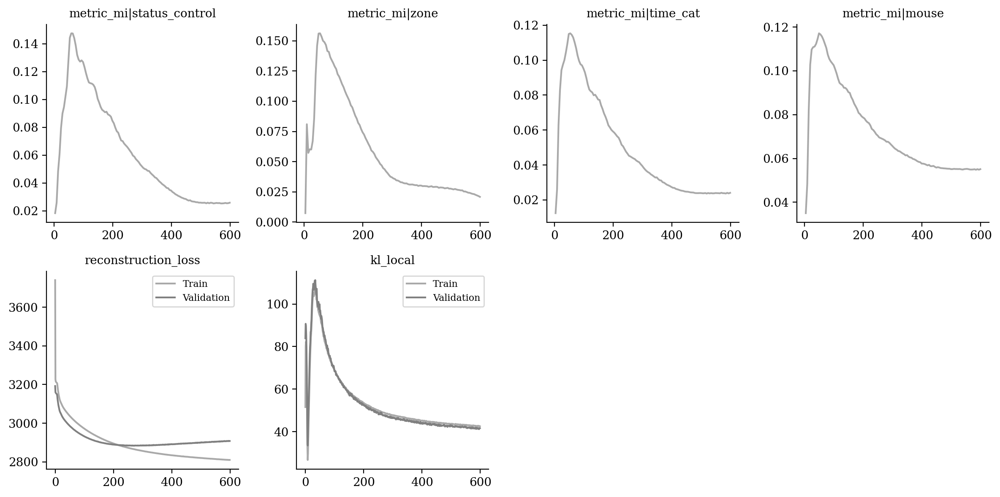

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

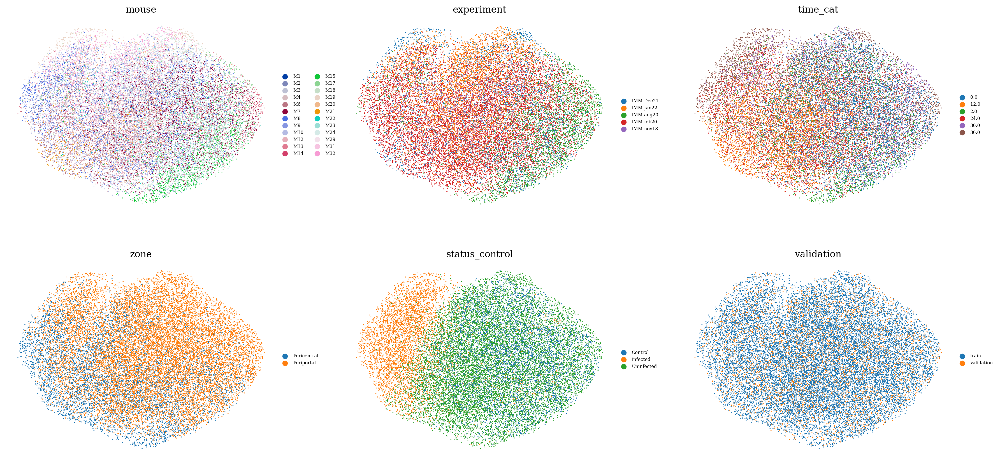

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

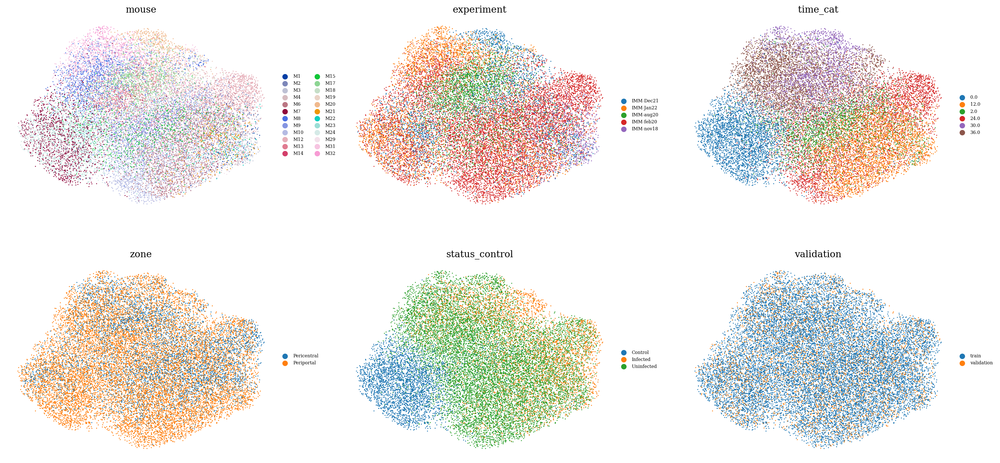

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

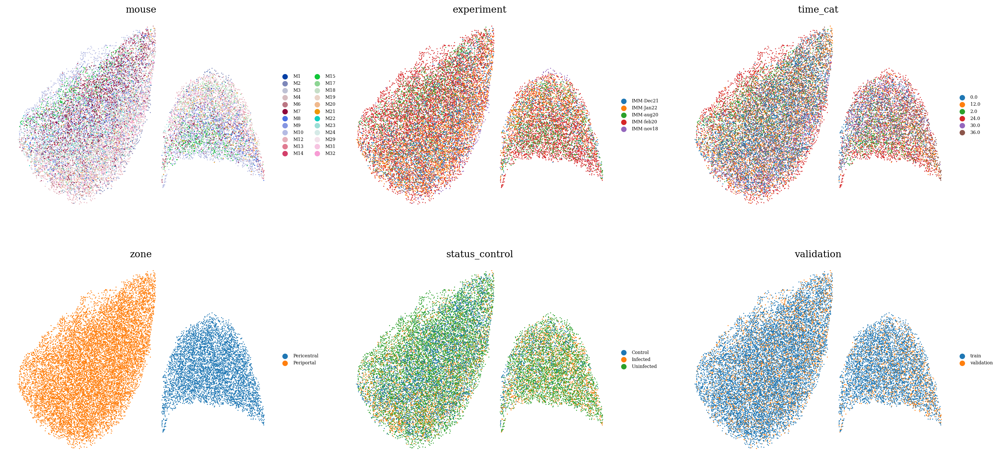

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

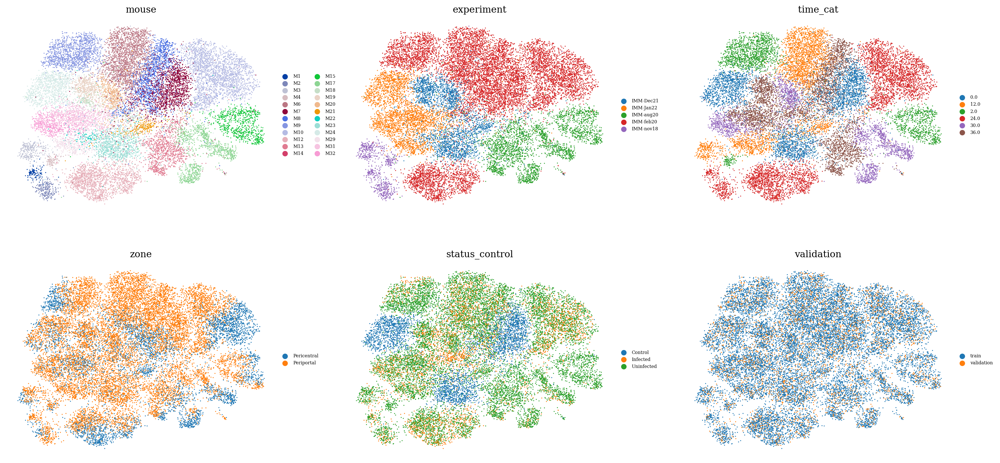

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

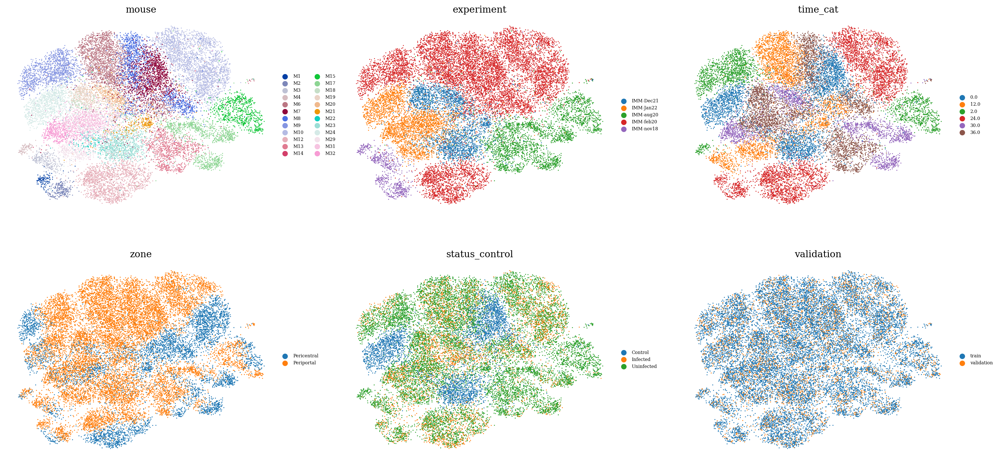

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

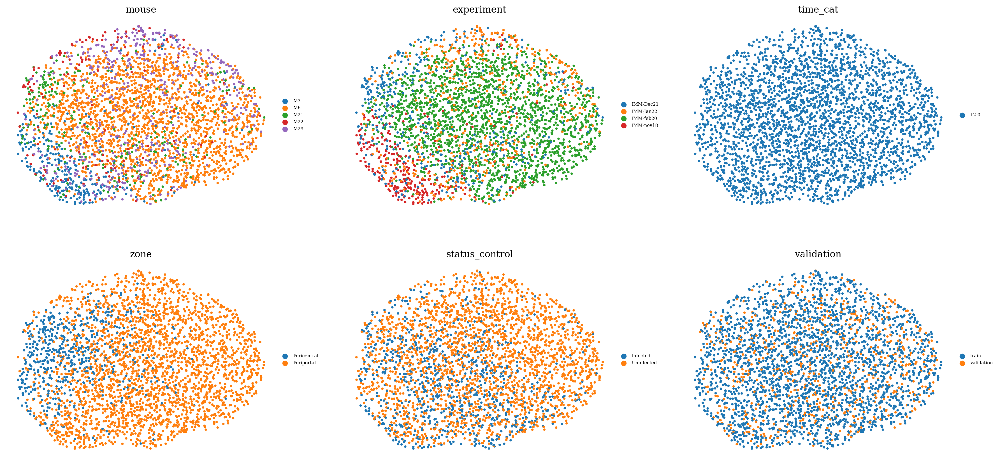

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )